# DeepWeeds / Weed-AI – Dataset & EDA (PyTorch)

This notebook does the following:

1. Load the WeedCOCO JSON (`weedcoco.json`) and build a pandas DataFrame  
   with one row per image and a single `category_id` + `class_name`.
2. Check **overall class distribution** (including the big `none` class).
3. Create a **stratified 60/20/20 split** (train / val / test) by class.
4. Define a simple `WeedDataset` for PyTorch.
5. Build **DataLoaders** for train / val / test.
6. Show **augmentation storyboards**:
   - For each class, pick **one image**.
   - Show: raw → aug1 → aug2 → aug3 for that same image.


In [2]:
# Basic imports
import os, json
from pathlib import Path
import json
import random

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

from PIL import Image

import torch
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms

from sklearn.model_selection import train_test_split

# For inline plots
%matplotlib inline

print("PyTorch version:", torch.__version__)

# Use MPS on Mac if available, else CPU
device = torch.device("mps") if torch.backends.mps.is_available() else torch.device("cpu")
print("Using device:", device)


PyTorch version: 2.9.1
Using device: mps


In [3]:
# %%
# ---- CONFIG ----

# Path to the folder that contains both:
#   - weedcoco.json
#   - images/  (with all the .jpg images)
PROJECT_ROOT = Path("/Users/wangtiles/Applcns_of_ML_remote_sensing/Weed_Detection_Project")

JSON_PATH = PROJECT_ROOT / "weedcoco.json"

# NOTE: in the JSON, file names typically look like "images/000001.jpg"
# so the effective image root is the same PROJECT_ROOT.
IMAGES_ROOT = PROJECT_ROOT

IMG_SIZE = 224
BATCH_SIZE = 32
RANDOM_SEED = 42

# Set seeds for reproducibility
torch.manual_seed(RANDOM_SEED)
np.random.seed(RANDOM_SEED)
random.seed(RANDOM_SEED)

print("PROJECT_ROOT exists:", PROJECT_ROOT.exists())
print("JSON_PATH exists:", JSON_PATH.exists())


PROJECT_ROOT exists: True
JSON_PATH exists: True


In [4]:
# %%
# Load the WeedCOCO JSON
with open(JSON_PATH, "r") as f:
    coco = json.load(f)

print("Top-level keys in coco:", coco.keys())
print("Number of images:", len(coco.get("images", [])))
print("Number of annotations:", len(coco.get("annotations", [])))
print("Number of categories:", len(coco.get("categories", [])))


Top-level keys in coco: dict_keys(['images', 'annotations', 'categories', 'agcontexts', 'info', 'licenses'])
Number of images: 17492
Number of annotations: 17492
Number of categories: 9


In [5]:
# %%
# Convert "images" and "annotations" into DataFrames
df_images = pd.DataFrame(coco["images"])[["id", "file_name"]]
df_images = df_images.rename(columns={"id": "image_id"})

df_annotations = pd.DataFrame(coco["annotations"])[["image_id", "category_id"]]
df_categories = pd.DataFrame(coco["categories"])[["id", "name"]].rename(
    columns={"id": "category_id", "name": "class_name"}
)

# Each image may have multiple annotations (e.g., multiple boxes of the same weed).
# For a simple image-level classification, we assign ONE label per image:
# here we just take the FIRST category_id for that image_id.
df_img_label = (
    df_annotations
    .groupby("image_id")["category_id"]
    .first()
    .reset_index()
)

# Merge image file names with their label
df = df_images.merge(df_img_label, on="image_id", how="inner")

# Add human-readable class_name
df = df.merge(df_categories, on="category_id", how="left")

print("DataFrame shape (rows = images with labels):", df.shape)
df.head()


DataFrame shape (rows = images with labels): (17492, 4)


,image_id,file_name,category_id,class_name
0,0,images/44179195d7afe4ce5cb9.jpg,0,weed: ziziphus mauritiana
1,1,images/d9c8a6da4da6af0f22ff.jpg,0,weed: ziziphus mauritiana
2,2,images/787ee4d4bd5854e700d5.jpg,0,weed: ziziphus mauritiana
3,3,images/8fafed4b9942a3b0be26.jpg,0,weed: ziziphus mauritiana
4,4,images/26ff7c309cbdfd00017f.jpg,0,weed: ziziphus mauritiana


Images per class (full dataset):


class_name
none                              9091
weed: chromolaena odorata         1072
weed: cryptostegia grandiflora    1009
weed: gutierrezia sarothrae       1016
weed: lantana camara              1064
weed: parkinsonia aculeata        1031
weed: parthenium hysterophorus    1022
weed: vachellia nilotica          1062
weed: ziziphus mauritiana         1125
Name: count, dtype: int64

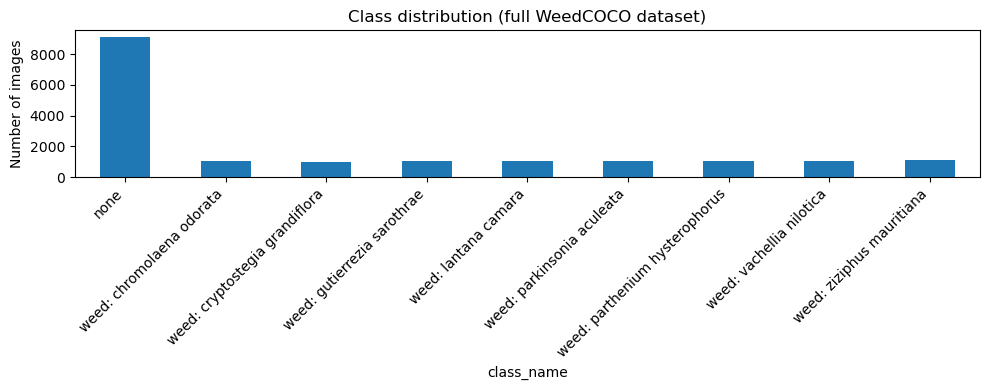

In [6]:
# %%
# Overall class distribution across all images
class_counts = df["class_name"].value_counts().sort_index()

print("Images per class (full dataset):")
display(class_counts)

plt.figure(figsize=(10, 4))
class_counts.plot(kind="bar")
plt.title("Class distribution (full WeedCOCO dataset)")
plt.ylabel("Number of images")
plt.xticks(rotation=45, ha="right")
plt.tight_layout()
plt.show()


Train size: 10495
Val size:   3498
Test size:  3499

Proportions (approx):
Train: 0.5999885662016922
Val:   0.1999771324033844
Test:  0.2000343013949234
Train counts:


class_name
none                              5455
weed: chromolaena odorata          643
weed: cryptostegia grandiflora     605
weed: gutierrezia sarothrae        610
weed: lantana camara               638
weed: parkinsonia aculeata         619
weed: parthenium hysterophorus     613
weed: vachellia nilotica           637
weed: ziziphus mauritiana          675
Name: count, dtype: int64


Val counts:


class_name
none                              1818
weed: chromolaena odorata          214
weed: cryptostegia grandiflora     202
weed: gutierrezia sarothrae        203
weed: lantana camara               213
weed: parkinsonia aculeata         206
weed: parthenium hysterophorus     205
weed: vachellia nilotica           212
weed: ziziphus mauritiana          225
Name: count, dtype: int64


Test counts:


class_name
none                              1818
weed: chromolaena odorata          215
weed: cryptostegia grandiflora     202
weed: gutierrezia sarothrae        203
weed: lantana camara               213
weed: parkinsonia aculeata         206
weed: parthenium hysterophorus     204
weed: vachellia nilotica           213
weed: ziziphus mauritiana          225
Name: count, dtype: int64

<Figure size 1200x500 with 0 Axes>

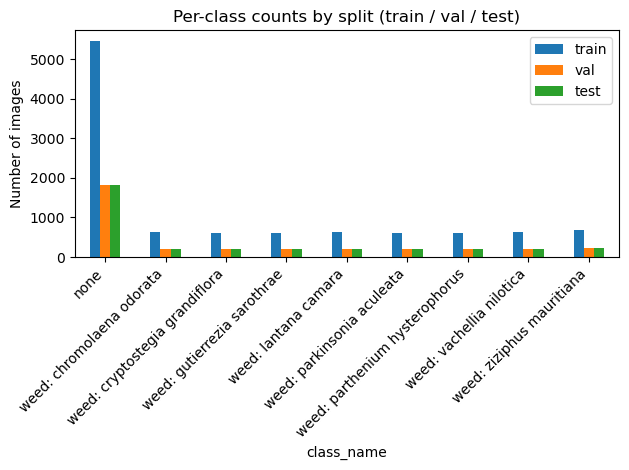

In [9]:
# %%
# A stratified 60/20/20 split by class_name.

# Use numeric labels for stratification (category_id)
labels = df["category_id"].values
indices = np.arange(len(df))

# Step 1: train (60%) vs temp (40%)
train_idx, temp_idx, y_train, y_temp = train_test_split(
    indices,
    labels,
    test_size=0.4,          # 40% in temp
    random_state=RANDOM_SEED,
    stratify=labels
)

# Step 2: val (20%) vs test (20%) from temp
val_idx, test_idx, y_val, y_test = train_test_split(
    temp_idx,
    y_temp,
    test_size=0.5,          # half of 40% → 20% total
    random_state=RANDOM_SEED,
    stratify=y_temp
)

print(f"Train size: {len(train_idx)}")
print(f"Val size:   {len(val_idx)}")
print(f"Test size:  {len(test_idx)}")

n_total = len(df)
print("\nProportions (approx):")
print("Train:", len(train_idx) / n_total)
print("Val:  ", len(val_idx) / n_total)
print("Test: ", len(test_idx) / n_total)
# %%
def counts_for_split(idx_array, df_full):
    subset = df_full.iloc[idx_array]
    counts = subset["class_name"].value_counts().sort_index()
    return counts

train_counts = counts_for_split(train_idx, df)
val_counts   = counts_for_split(val_idx, df)
test_counts  = counts_for_split(test_idx, df)

print("Train counts:")
display(train_counts)
print("\nVal counts:")
display(val_counts)
print("\nTest counts:")
display(test_counts)

# Combine into one DataFrame for plotting
split_counts = pd.DataFrame({
    "train": train_counts,
    "val": val_counts,
    "test": test_counts
}).fillna(0)

plt.figure(figsize=(12, 5))
split_counts.plot(kind="bar")
plt.title("Per-class counts by split (train / val / test)")
plt.ylabel("Number of images")
plt.xticks(rotation=45, ha="right")
plt.tight_layout()
plt.show()



In [10]:
# %%
# ImageNet mean & std for normalization
IMAGENET_MEAN = [0.485, 0.456, 0.406]
IMAGENET_STD  = [0.229, 0.224, 0.225]

# ---- Training transform ----
# This is what will actually be applied DURING TRAINING:
# - Resize to 256x256
# - RandomResizedCrop to 224x224 (random zoom/crop)
# - Random horizontal flip
# - Color jitter (brightness/contrast/saturation)
# - Convert to tensor
# - Normalize to ImageNet stats
train_transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.RandomResizedCrop(IMG_SIZE, scale=(0.8, 1.0)),
    transforms.RandomHorizontalFlip(p=0.5),
    transforms.ColorJitter(
        brightness=0.2,
        contrast=0.2,
        saturation=0.2
    ),
    transforms.ToTensor(),
    transforms.Normalize(mean=IMAGENET_MEAN, std=IMAGENET_STD),
])

# ---- Eval transform ----
# Used for validation and test:
# - Deterministic Resize to 224x224
# - ToTensor
# - Normalize to ImageNet stats
eval_transform = transforms.Compose([
    transforms.Resize((IMG_SIZE, IMG_SIZE)),
    transforms.ToTensor(),
    transforms.Normalize(mean=IMAGENET_MEAN, std=IMAGENET_STD),
])

# ---- Visualization transform ----
# For EDA, we want to SEE images without weird normalized colors.
# So we use the SAME geometric + color operations as train, but WITHOUT normalize.
vis_aug_transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.RandomResizedCrop(IMG_SIZE, scale=(0.8, 1.0)),
    transforms.RandomHorizontalFlip(p=0.5),
    transforms.ColorJitter(
        brightness=0.2,
        contrast=0.2,
        saturation=0.2
    ),
    transforms.ToTensor(),   # stays in [0,1], no normalization
])

# Simple resize-only (no aug, no norm) to show "raw" image
vis_raw_transform = transforms.Compose([
    transforms.Resize((IMG_SIZE, IMG_SIZE)),
    transforms.ToTensor(),   # [0,1]
])


In [11]:
# %%
class WeedDataset(Dataset):
    """
    Very simple custom Dataset:
    - df: DataFrame with columns 'file_name' and 'category_id'
    - root_dir: Path where 'weedcoco.json' and 'images/' live
    - transform: any torchvision transform to apply (train / eval / vis)
    """
    def __init__(self, df, root_dir, transform=None):
        # Reset index so that __getitem__ can safely use integer positions
        self.df = df.reset_index(drop=True)
        self.root_dir = Path(root_dir)
        self.transform = transform

    def __len__(self):
        # Total number of samples
        return len(self.df)

    def __getitem__(self, idx):
        # Grab the row
        row = self.df.iloc[idx]

        # Build full path to image file
        img_path = self.root_dir / row["file_name"]  # file_name e.g. "images/000001.jpg"

        # Open image as RGB
        image = Image.open(img_path).convert("RGB")

        # Numeric label for this image
        label = int(row["category_id"])

        # Apply transform (if any)
        if self.transform is not None:
            image = self.transform(image)

        # Return (image_tensor, label_int)
        return image, label


In [12]:
# %%
# Build separate DataFrames for each split
train_df = df.iloc[train_idx]
val_df   = df.iloc[val_idx]
test_df  = df.iloc[test_idx]

print("Train df shape:", train_df.shape)
print("Val df shape:  ", val_df.shape)
print("Test df shape: ", test_df.shape)

# Create Dataset objects
train_dataset = WeedDataset(train_df, root_dir=IMAGES_ROOT, transform=train_transform)
val_dataset   = WeedDataset(val_df, root_dir=IMAGES_ROOT, transform=eval_transform)
test_dataset  = WeedDataset(test_df, root_dir=IMAGES_ROOT, transform=eval_transform)

# DataLoaders
# NOTE: num_workers=0 avoids multiprocessing pickling headaches in Jupyter + Mac.
train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True,  num_workers=0)
val_loader   = DataLoader(val_dataset,   batch_size=BATCH_SIZE, shuffle=False, num_workers=0)
test_loader  = DataLoader(test_dataset,  batch_size=BATCH_SIZE, shuffle=False, num_workers=0)

print("Number of train batches:", len(train_loader))
print("Number of val batches:  ", len(val_loader))
print("Number of test batches: ", len(test_loader))


Train df shape: (10495, 4)
Val df shape:   (3498, 4)
Test df shape:  (3499, 4)
Number of train batches: 328
Number of val batches:   110
Number of test batches:  110


Class IDs: [np.int64(0), np.int64(1), np.int64(2), np.int64(3), np.int64(4), np.int64(5), np.int64(6), np.int64(7), np.int64(8)]
ID -> name mapping: {0: 'weed: ziziphus mauritiana', 1: 'weed: lantana camara', 8: 'none', 7: 'weed: gutierrezia sarothrae', 6: 'weed: chromolaena odorata', 4: 'weed: vachellia nilotica', 3: 'weed: parthenium hysterophorus', 5: 'weed: cryptostegia grandiflora', 2: 'weed: parkinsonia aculeata'}
Class 0: weed: ziziphus mauritiana


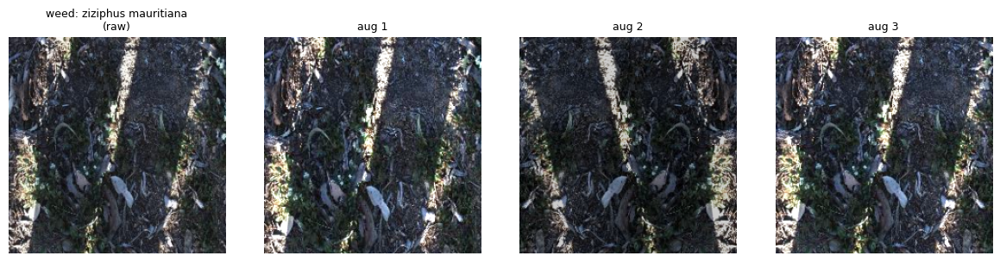

Class 1: weed: lantana camara


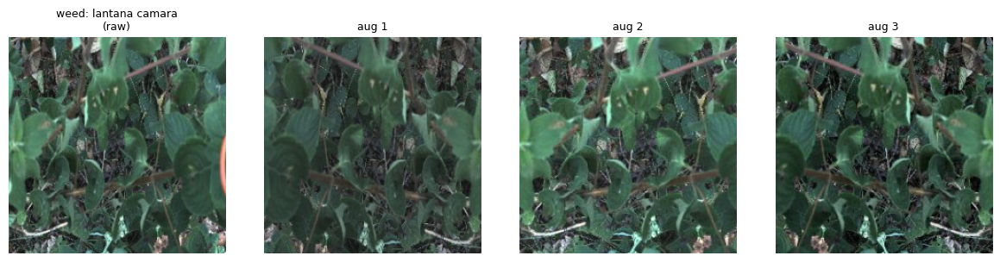

Class 2: weed: parkinsonia aculeata


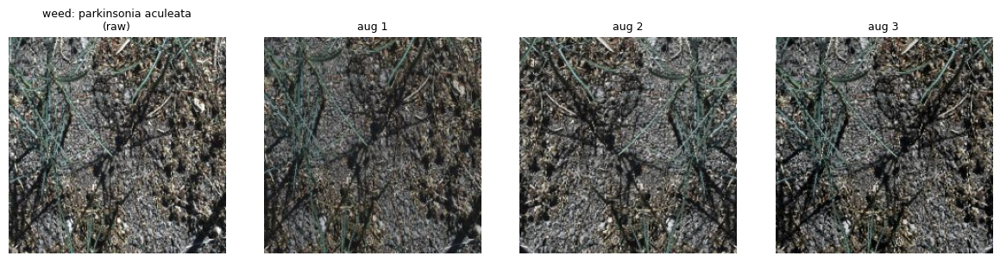

Class 3: weed: parthenium hysterophorus


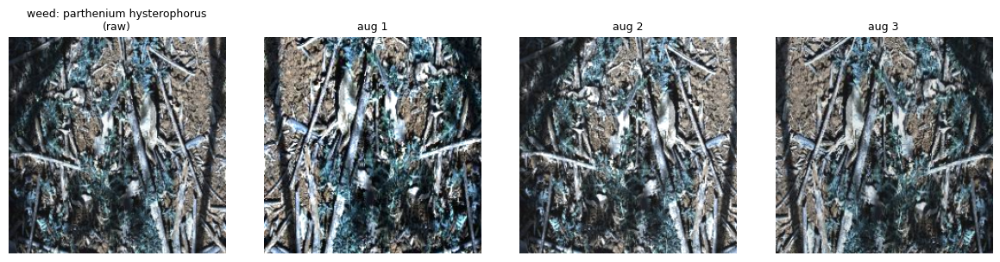

Class 4: weed: vachellia nilotica


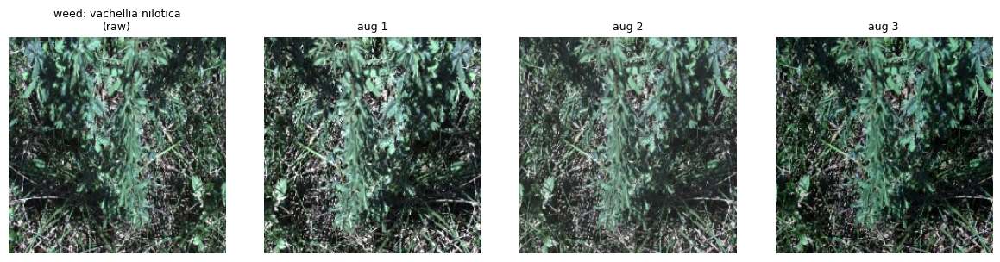

Class 5: weed: cryptostegia grandiflora


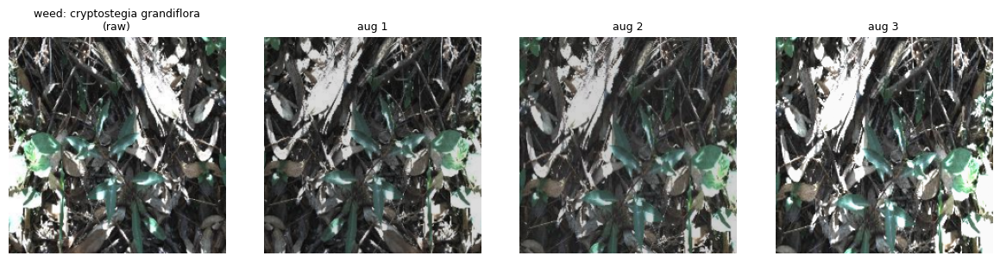

Class 6: weed: chromolaena odorata


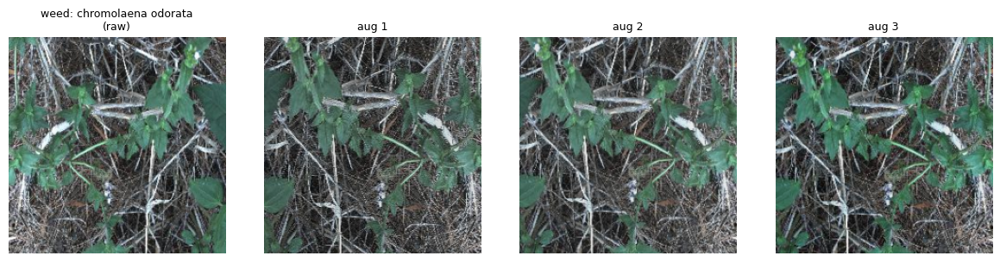

Class 7: weed: gutierrezia sarothrae


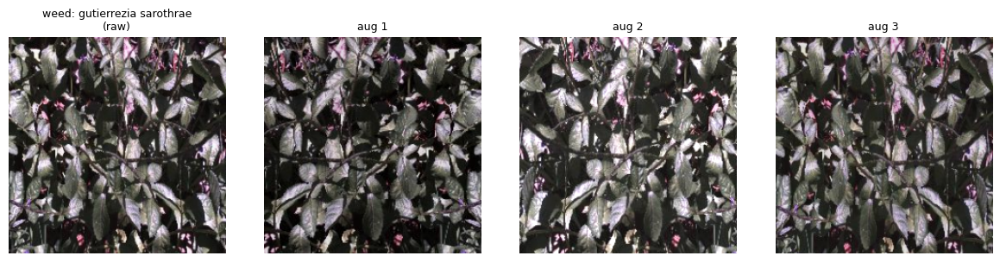

Class 8: none


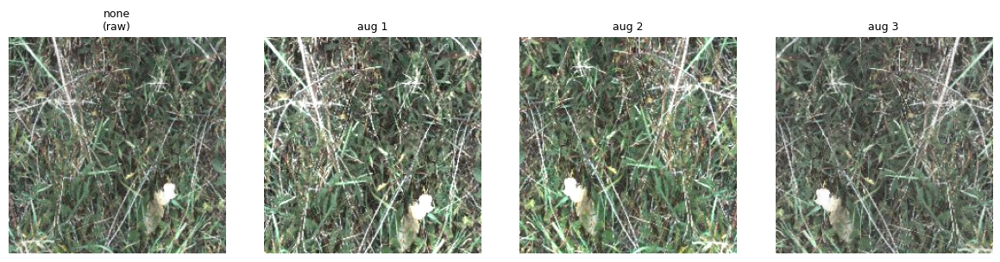

In [14]:
"""First we display the raw image, then the cropped image, then the next augmentation, then another augmentation. Same image. Do this for each class."""
# Build a mapping from category_id -> class_name to show nice titles
id_to_name = (
    df_categories
    .set_index("category_id")["class_name"]
    .to_dict()
)

unique_class_ids = sorted(df["category_id"].unique())
print("Class IDs:", unique_class_ids)
print("ID -> name mapping:", id_to_name)

def show_augmentations_for_class(class_id, df_full, root_dir, n_aug=3):
    """
    For a given class_id:
    - pick ONE random image from that class,
    - show:
        [0] raw resized image (no aug),
        [1..n_aug] different augmented versions.
    """
    # Filter DF to get rows for this class
    df_class = df_full[df_full["category_id"] == class_id]

    if len(df_class) == 0:
        print(f"No images found for class_id {class_id}")
        return

    # Pick one random row
    row = df_class.sample(1, random_state=random.randint(0, 99999)).iloc[0]

    img_path = Path(root_dir) / row["file_name"]
    pil_img = Image.open(img_path).convert("RGB")

    class_name = id_to_name.get(class_id, f"class {class_id}")

    # Prepare subplots: 1 row, 1 + n_aug columns
    total_cols = 1 + n_aug
    plt.figure(figsize=(total_cols * 3, 3))

    # Panel 0: "raw" resized view (no normalization / heavy aug)
    raw_tensor = vis_raw_transform(pil_img)   # [C,H,W] in [0,1]
    raw_img = raw_tensor.permute(1, 2, 0).numpy()

    plt.subplot(1, total_cols, 1)
    plt.imshow(raw_img)
    plt.axis("off")
    plt.title(f"{class_name}\n(raw)", fontsize=9)

    # Panels 1..n_aug: different augmented versions
    for i in range(n_aug):
        aug_tensor = vis_aug_transform(pil_img)  # random crop + flip + jitter
        aug_img = aug_tensor.permute(1, 2, 0).numpy()

        plt.subplot(1, total_cols, 2 + i)
        plt.imshow(aug_img)
        plt.axis("off")
        plt.title(f"aug {i+1}", fontsize=9)

    plt.tight_layout()
    plt.show()

# Actually generate storyboards for ALL classes (including 'none')
for cid in unique_class_ids:
    print(f"Class {cid}: {id_to_name.get(cid)}")
    show_augmentations_for_class(cid, df, IMAGES_ROOT, n_aug=3)


Class 0 – weed: ziziphus mauritiana


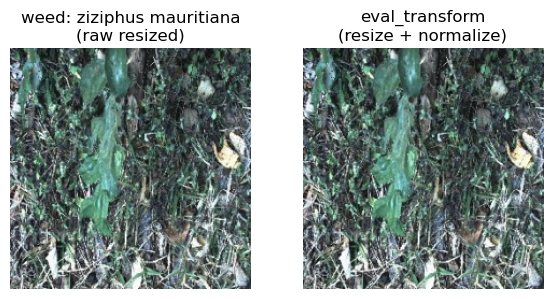

Class 1 – weed: lantana camara


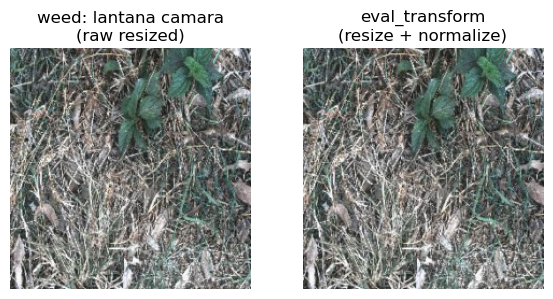

Class 2 – weed: parkinsonia aculeata


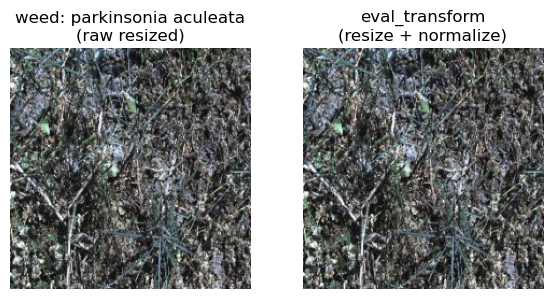

Class 3 – weed: parthenium hysterophorus


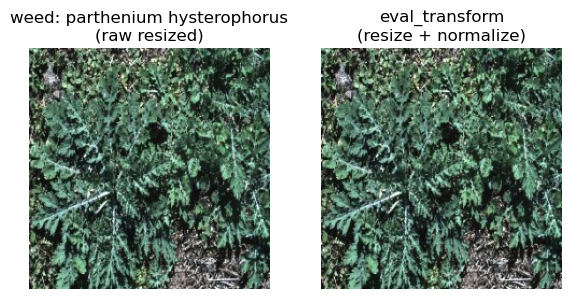

Class 4 – weed: vachellia nilotica


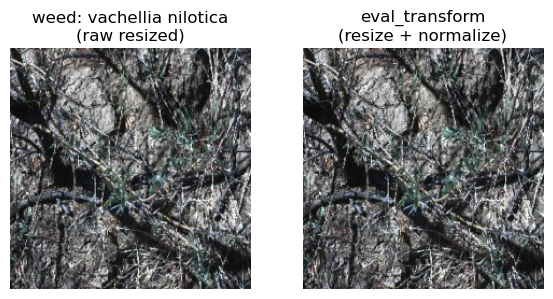

Class 5 – weed: cryptostegia grandiflora


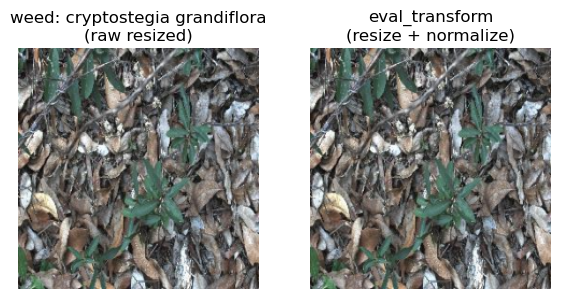

Class 6 – weed: chromolaena odorata


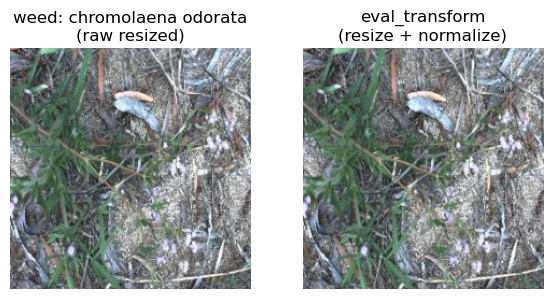

Class 7 – weed: gutierrezia sarothrae


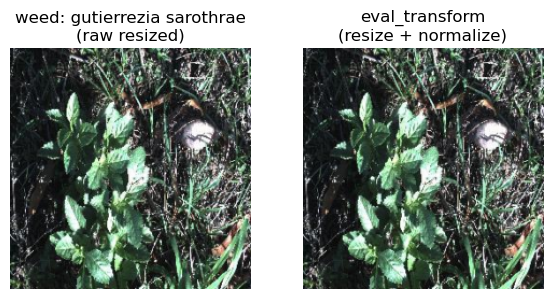

Class 8 – none


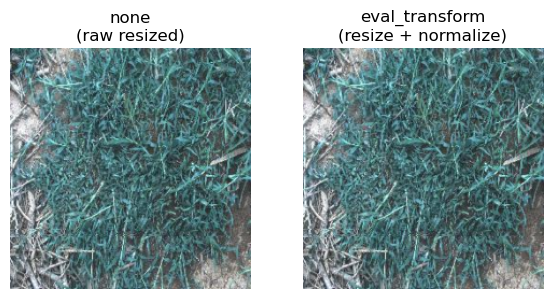

In [65]:
# %% 
# Helper: ImageNet mean/std
IMAGENET_MEAN = torch.tensor([0.485, 0.456, 0.406]).view(3,1,1)
IMAGENET_STD  = torch.tensor([0.229, 0.224, 0.225]).view(3,1,1)

def unnormalize(t):
    """
    Undo ImageNet normalization so we can visualize the image.
    Input:  tensor [3,H,W]
    Output: numpy array [H,W,3] in [0,1]
    """
    t = t.clone()
    t = t * IMAGENET_STD + IMAGENET_MEAN
    return t.permute(1,2,0).clamp(0,1).numpy()

def show_eval_transform_for_class(class_id, df_full, root_dir):
    """
    For a given class:
      - sample 1 image
      - show:
          (1) Raw resized image
          (2) eval_transform(img) → unnormalized for display
    """
    df_class = df_full[df_full["category_id"] == class_id]
    if len(df_class) == 0:
        print(f"No images found for class {class_id}")
        return

    # pick 1 row from this class
    row = df_class.sample(1).iloc[0]
    img_path = Path(root_dir) / row["file_name"]
    pil_img = Image.open(img_path).convert("RGB")

    # --- panel 1: raw resized view ---
    raw_tensor = transforms.Resize((IMG_SIZE, IMG_SIZE))(pil_img)
    raw_np = np.array(raw_tensor) / 255.0  # convert to float [0,1]

    # --- panel 2: eval (resize + tensor + normalize), then unnormalize ---
    eval_tensor = eval_transform(pil_img)  # [C,H,W] normalized
    eval_np = unnormalize(eval_tensor)     # back to viewable [H,W,3]

    class_name = id_to_name[class_id]

    # plot
    plt.figure(figsize=(6,3))
    
    plt.subplot(1,2,1)
    plt.imshow(raw_np)
    plt.axis("off")
    plt.title(f"{class_name}\n(raw resized)")

    plt.subplot(1,2,2)
    plt.imshow(eval_np)
    plt.axis("off")
    plt.title("eval_transform\n(resize + normalize)")

    plt.tight_layout()
    plt.show()

# Run visualization for ALL classes (including 'none')
for cid in sorted(id_to_name.keys()):
    print(f"Class {cid} – {id_to_name[cid]}")
    show_eval_transform_for_class(cid, df, IMAGES_ROOT)


## Data Preprocessing and Augmentation Choices

Before training the classifier, I decided to design a small but deliberate set of image transformations. The goal is not to make the dataset “look fancy”, but to make the model more robust to realistic variation in the field while staying close to the original DeepWeeds preprocessing pipeline.

I separate preprocessing into two categories:

- **Geometric + color augmentations for training only**  
- **Deterministic transforms + normalization for validation and test**

### Training-time augmentations

For the training set, I apply the following operations (in order):

1. **Resize to 256×256 pixels**

   I first resize each image to a slightly larger square (256×256). This gives a consistent starting canvas and a bit of “room” for random cropping. It roughly mirrors what the original DeepWeeds paper did (resize to a larger size, then crop down to 224×224).

2. **RandomResizedCrop to 224×224**

   From the 256×256 image, I take a random crop and resize it to 224×224 (the input size expected by ResNet).  
   This does two things for me:

   - Simulates the weed appearing at slightly different **scales and positions** in the frame.  
   - Encourages the model not to overfit to a very specific framing of the plant.

   In practice, the same weed might be photographed a bit closer, a bit further, or slightly off-center in different images. RandomResizedCrop forces the network to rely on the plant’s **visual pattern**, not the exact pixel location.

3. **Random horizontal flip (p = 0.5)**

   I randomly flip the image left–right with 50% probability.  
   For a weed in a paddock or roadside environment, there is no “canonical left vs right” orientation that carries semantic meaning. Flipping therefore:

   - Doubles the effective variety of poses/orientations.
   - Helps the model become invariant to the direction the plant (or camera) happens to face.

4. **Color jitter (brightness, contrast, saturation)**

   I apply a mild `ColorJitter` on brightness, contrast, and saturation. This is meant to mimic:

   - Different lighting conditions (cloudy vs sunny, harsh shadows).  
   - Slight changes in camera exposure or white balance.  

   Field imagery is often messy and inconsistent. If the model only sees perfectly lit, nicely exposed images, it will struggle when the light is slightly off. Jittering these values nudges the network to focus more on **shape and texture** of the weed rather than overfitting to one particular lighting setup.

5. **ToTensor + ImageNet normalization**

   Finally, I convert the PIL image to a PyTorch tensor and normalize it using the standard ImageNet mean and standard deviation:

   - `mean = [0.485, 0.456, 0.406]`  
   - `std  = [0.229, 0.224, 0.225]`

   This step is important because I am starting from **ImageNet-pretrained ResNet weights**. Those weights were trained under this exact normalization scheme, so feeding images in the same normalized space keeps the activations in a stable range and makes fine-tuning behave as expected.

### Validation / test transforms

For validation and test sets, I deliberately remove all randomness:

- **Resize directly to 224×224**
- **ToTensor**
- **ImageNet normalization (same as above)**

Here, the goal is **stable, repeatable evaluation**, not extra data variety. I want my validation and test metrics to reflect how the model behaves on a fixed input distribution, without any noise injected by random crops or jitter.

### Visualization transforms

For EDA and qualitative checks, I also define “visualization” transforms:

- A **raw visualization transform**: resize to 224×224 and convert to tensor without normalization.  
- An **augmented visualization transform**: same geometric + color operations as the training pipeline, but without normalization so I can actually see the colors.

I use these to create “storyboards” for one image per class:

- Left: the raw resized image.  
- Right: multiple augmented versions of the **same** image.

This makes it easy to inspect what the network will actually see during training and to justify that the augmentations are reasonable and not overly aggressive.

In summary, these design choices are meant to:

- Stay faithful in spirit to the DeepWeeds preprocessing (resize, crop, flip, normalize).
- Add just enough augmentation (crop, flip, color) to improve generalization.
- Keep evaluation deterministic and clean.
- Be transparent and inspectable via the augmentation visualizations.


# ResNet Training and Evaluation


## ResNet18 – First Training Run (Smoke Test)

Now that the dataset and augmentations are set up, I want to run a **small, lightweight experiment** with ResNet18 before committing to ResNet50.

The goals of this first run are:

- Verify that the **PyTorch data pipeline** (transforms → Dataset → DataLoader) works end-to-end.
- Check that the **loss decreases** and **validation accuracy increases** over a few epochs.
- Measure roughly **how long one epoch takes** on my M1 GPU (MPS backend) for this dataset.

For this initial experiment, I will:

- Use **ResNet18** with ImageNet-pretrained weights from `torchvision`.
- Replace the final fully connected (`fc`) layer to output **9 classes** (the weed categories).
- Use **CrossEntropyLoss** (standard for multi-class classification).
- Use the **Adam** optimizer with a small learning rate.
- Train only for **3 epochs** as a “smoke test”.

If this behaves sensibly (no crashes, reasonable learning curve), I will then:

- Swap to **ResNet50**,
- Add **early stopping / learning rate scheduling**,
- And run a deeper training for the main results and Grad-CAM analysis.


In [ ]:
# ResNet18 model setup: use ImageNet-pretrained backbone and adapt it to 9 weed classes.

import torch.nn as nn
from torchvision import models

# Number of classes = how many weed categories we have
NUM_CLASSES = len(id_to_name)  # id_to_name already maps label_id -> class_name
print("Number of classes:", NUM_CLASSES)
print("Classes:", id_to_name)

# Build ResNet18 with ImageNet-pretrained weights
# (pretrained=True is fine; newer torchvision just warns but still works)
resnet18 = models.resnet18(pretrained=True)

# Replace the final classification layer (fc) to match our number of classes
in_features = resnet18.fc.in_features
resnet18.fc = nn.Linear(in_features, NUM_CLASSES)

# Move model to device (MPS or CPU)
resnet18 = resnet18.to(device)

print(resnet18.fc)


Number of classes: 9
Classes: {0: 'weed: ziziphus mauritiana', 1: 'weed: lantana camara', 8: 'none', 7: 'weed: gutierrezia sarothrae', 6: 'weed: chromolaena odorata', 4: 'weed: vachellia nilotica', 3: 'weed: parthenium hysterophorus', 5: 'weed: cryptostegia grandiflora', 2: 'weed: parkinsonia aculeata'}
Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /Users/wangtiles/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth


/Library/anaconda3/envs/rs-ml/lib/python3.11/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/Library/anaconda3/envs/rs-ml/lib/python3.11/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
100.0%


Linear(in_features=512, out_features=9, bias=True)


### Loss function, optimizer, and accuracy metric

Next, I define the core training ingredients:

- **Loss function**:  
  I use `nn.CrossEntropyLoss`, which is the standard choice for multi-class classification.  
  It expects:
  - model outputs: unnormalized scores (logits) of shape `(batch_size, num_classes)`
  - labels: integer class indices of shape `(batch_size,)`

- **Optimizer**:  
  I start with `Adam` and a small learning rate (e.g., `1e-4`). This is usually a safe default for fine-tuning a pretrained backbone.

- **Accuracy helper**:  
  For monitoring training, I compute simple **top-1 accuracy**:
  - Take `argmax` over the class dimension,
  - Compare with the true labels,
  - Count how many predictions are correct.

This gives me a quick sense of whether the model is learning anything meaningful across epochs.


In [ ]:
import torch.optim as optim

# Loss function: standard multi-class classification loss
criterion = nn.CrossEntropyLoss()

# Optimizer: Adam with a small learning rate
optimizer = optim.Adam(resnet18.parameters(), lr=1e-4)

def compute_accuracy(logits, labels):
    """
    Compute simple top-1 accuracy given model outputs (logits) and true labels.
    """
    # preds: indices of the max logit along the class dimension
    preds = torch.argmax(logits, dim=1)
    correct = (preds == labels).sum().item()
    total = labels.size(0)
    return correct, total


### Training and validation loops

Here I define two helper functions:

1. `train_one_epoch`:
   - Puts the model in `train()` mode,
   - Loops over the **train_loader**,
   - Moves data to the chosen device (MPS/CPU),
   - Runs forward pass → loss → backward pass → optimizer step,
   - Tracks running **loss** and **accuracy** over the epoch.

2. `evaluate_one_epoch`:
   - Puts the model in `eval()` mode,
   - Loops over the **val_loader**,
   - Runs forward pass **without gradients**,
   - Tracks **validation loss** and **accuracy**.

I use these functions to keep the main training loop clean and easy to read.


In [17]:
def train_one_epoch(model, loader, optimizer, criterion, device):
    """
    Train the model for ONE epoch on the given DataLoader.
    
    Returns:
        avg_loss (float), avg_accuracy (float in [0, 1])
    """
    model.train()
    running_loss = 0.0
    running_correct = 0
    running_total = 0

    for images, labels in loader:
        images = images.to(device)
        labels = labels.to(device)

        # Forward pass
        outputs = model(images)
        loss = criterion(outputs, labels)

        # Backprop + optimize
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        # Accumulate stats
        running_loss += loss.item() * images.size(0)  # sum of batch losses
        correct, total = compute_accuracy(outputs, labels)
        running_correct += correct
        running_total += total

    avg_loss = running_loss / running_total
    avg_acc = running_correct / running_total
    return avg_loss, avg_acc


def evaluate_one_epoch(model, loader, criterion, device):
    """
    Evaluate the model for ONE epoch on the given DataLoader (val or test).
    
    Returns:
        avg_loss (float), avg_accuracy (float in [0, 1])
    """
    model.eval()
    running_loss = 0.0
    running_correct = 0
    running_total = 0

    # No gradients needed for evaluation
    with torch.no_grad():
        for images, labels in loader:
            images = images.to(device)
            labels = labels.to(device)

            outputs = model(images)
            loss = criterion(outputs, labels)

            running_loss += loss.item() * images.size(0)
            correct, total = compute_accuracy(outputs, labels)
            running_correct += correct
            running_total += total

    avg_loss = running_loss / running_total
    avg_acc = running_correct / running_total
    return avg_loss, avg_acc


### First small experiment: 3-epoch ResNet18 run

Now I run a **short 3-epoch training** with ResNet18 on my stratified 60/20/20 split.

The aim is to:

- Confirm that the training loop runs without errors.
- Verify that:
  - Training loss decreases across epochs.
  - Validation accuracy is at least better than random (1/9 ≈ 11.1%).
- Get a rough **time-per-epoch** estimate on my machine.

If this looks stable and sensible, I will then:

- Switch to **ResNet50**,
- Increase the number of epochs (with early stopping),
- And later evaluate on the held-out test set and run Grad-CAM.


In [18]:

num_epochs = 3  # small smoke test; you can increase later if this looks good

train_history = []
val_history = []

for epoch in range(1, num_epochs + 1):
    print(f"Epoch {epoch}/{num_epochs}")

    train_loss, train_acc = train_one_epoch(
        resnet18, train_loader, optimizer, criterion, device
    )
    val_loss, val_acc = evaluate_one_epoch(
        resnet18, val_loader, criterion, device
    )

    train_history.append((train_loss, train_acc))
    val_history.append((val_loss, val_acc))

    print(
        f"  Train loss: {train_loss:.4f} | Train acc: {train_acc*100:.2f}%\n"
        f"  Val   loss: {val_loss:.4f} | Val   acc: {val_acc*100:.2f}%"
    )


Epoch 1/3
  Train loss: 0.6819 | Train acc: 76.91%
  Val   loss: 0.4378 | Val   acc: 84.88%
Epoch 2/3
  Train loss: 0.3220 | Train acc: 89.25%
  Val   loss: 0.3199 | Val   acc: 89.42%
Epoch 3/3
  Train loss: 0.2420 | Train acc: 91.45%
  Val   loss: 0.3184 | Val   acc: 89.17%


## ResNet50 – Main Training Run

The ResNet18 experiment confirmed that:

- The Weed-AI dataset → PyTorch `DataLoader` pipeline is working correctly.
- The model can learn meaningful patterns (validation accuracy ~89% after 3 epochs).

Now I move to the **main model** I want to report in my project:

- **Backbone**: `torchvision.models.resnet50` with ImageNet-pretrained weights.
- **Head**: Replace the final fully connected (`fc`) layer with a new `Linear` layer that outputs 9 logits (one per weed class).
- **Fine-tuning**: I will fine-tune the **entire network** (not just the head), but with a relatively small learning rate.

I will also:
- Use the same **CrossEntropyLoss** and a slightly reduced learning rate for ResNet50.
- Reuse the training and evaluation functions I already defined (`train_one_epoch`, `evaluate_one_epoch`).
- Add a simple **early stopping** mechanism based on validation loss, with a patience of a few epochs.

This ResNet50 run will be the main model I later:
- Evaluate on the **held-out test set**,
- Use for **Grad-CAM** visualizations,
- And discuss in my final report.


In [ ]:
# Build ResNet50 model with ImageNet-pretrained weights and a new 9-class head.

from torchvision import models
import torch.nn as nn

# Re-define NUM_CLASSES just to be explicit here
NUM_CLASSES = len(id_to_name)
print("Number of classes:", NUM_CLASSES)

# Create a fresh ResNet50 (we don't reuse ResNet18 weights here)
resnet50 = models.resnet50(pretrained=True)

# Replace the final fully connected layer to output NUM_CLASSES logits
in_features_50 = resnet50.fc.in_features
resnet50.fc = nn.Linear(in_features_50, NUM_CLASSES)

# Move the model to the device (MPS or CPU)
resnet50 = resnet50.to(device)

print(resnet50.fc)

"""
from torchvision.models import resnet50, ResNet50_Weights
model = resnet50(weights=ResNet50_Weights.IMAGENET1K_V1)  # equivalent to pretrained=True   
"""


Number of classes: 9


/Library/anaconda3/envs/rs-ml/lib/python3.11/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /Users/wangtiles/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth


100.0%


Linear(in_features=2048, out_features=9, bias=True)


### Loss, optimizer, and early stopping setup for ResNet50

For the main ResNet50 training:

- **Loss function**: I keep using `nn.CrossEntropyLoss`, since it is the standard for multi-class image classification.

- **Optimizer**: I use `Adam` again, but with a slightly conservative learning rate, e.g. `1e-4`.  
  Since we are fine-tuning a larger network (ResNet50) on a reasonably sized dataset, a small LR is a good balance between speed and stability.

- **Early stopping**:
  - I will train for **up to 30 epochs**, but I don’t want to overfit or waste time.
  - I track the **validation loss** after each epoch.
  - If the validation loss does not improve for a certain number of epochs (e.g. `patience = 5`), I stop early and restore the **best** model weights (the epoch with lowest val loss).

This gives me:
- Enough capacity (ResNet50),
- Reasonable training time,
- And some protection against overfitting via early stopping.


In [20]:

import torch.optim as optim
import copy

# Loss function (same as before)
criterion_50 = nn.CrossEntropyLoss()

# Optimizer for ResNet50
optimizer_50 = optim.Adam(resnet50.parameters(), lr=1e-4)

# Early stopping settings
max_epochs = 30
patience = 5  # stop if val loss doesn't improve for 5 epochs

best_val_loss = float("inf")
best_model_state = copy.deepcopy(resnet50.state_dict())
epochs_without_improvement = 0

train_history_50 = []
val_history_50 = []


### Training loop for ResNet50 (with early stopping)

Now I train ResNet50 on the **train set**, monitor performance on the **validation set**, and apply early stopping:

For each epoch:
- Run one epoch of training using `train_one_epoch`.
- Evaluate on the validation set using `evaluate_one_epoch`.
- Log:
  - Training loss and accuracy,
  - Validation loss and accuracy.

Early stopping logic:
- If the **validation loss** improves (lower than previous best), I:
  - Update `best_val_loss`,
  - Save a copy of the model’s state (`best_model_state`),
  - Reset the patience counter.
- Otherwise, I increment the `epochs_without_improvement` counter.
- If `epochs_without_improvement` exceeds my `patience`, I break out of training and restore the best model weights.

This gives me a final ResNet50 model that corresponds to the “best” validation-loss epoch, not necessarily the last epoch.


In [ ]:

for epoch in range(1, max_epochs + 1):
    print(f"Epoch {epoch}/{max_epochs}")

    train_loss, train_acc = train_one_epoch(
        resnet50, train_loader, optimizer_50, criterion_50, device
    )
    val_loss, val_acc = evaluate_one_epoch(
        resnet50, val_loader, criterion_50, device
    )

    train_history_50.append((train_loss, train_acc))
    val_history_50.append((val_loss, val_acc))

    print(
        f"  Train loss: {train_loss:.4f} | Train acc: {train_acc*100:.2f}%\n"
        f"  Val   loss: {val_loss:.4f} | Val   acc: {val_acc*100:.2f}%"
    )

    # Early stopping check
    if val_loss < best_val_loss:
        best_val_loss = val_loss
        best_model_state = copy.deepcopy(resnet50.state_dict())
        epochs_without_improvement = 0
        print(" New best model (val loss improved).")
    else:
        epochs_without_improvement += 1
        print(f" No improvement in val loss for {epochs_without_improvement} epoch(s).")

    if epochs_without_improvement > patience:
        print(" Early stopping triggered.")
        break

# Restore best model weights
resnet50.load_state_dict(best_model_state)
print("Loaded best ResNet50 weights (based on val loss).")


Epoch 1/30
  Train loss: 0.6157 | Train acc: 79.39%
  Val   loss: 0.3580 | Val   acc: 88.11%
  ✅ New best model (val loss improved).
Epoch 2/30
  Train loss: 0.3333 | Train acc: 88.59%
  Val   loss: 0.3382 | Val   acc: 89.25%
  ✅ New best model (val loss improved).
Epoch 3/30
  Train loss: 0.2435 | Train acc: 91.67%
  Val   loss: 0.2621 | Val   acc: 92.31%
  ✅ New best model (val loss improved).
Epoch 4/30
  Train loss: 0.1831 | Train acc: 93.82%
  Val   loss: 0.2302 | Val   acc: 92.40%
  ✅ New best model (val loss improved).
Epoch 5/30
  Train loss: 0.1642 | Train acc: 94.20%
  Val   loss: 0.2094 | Val   acc: 93.48%
  ✅ New best model (val loss improved).
Epoch 6/30
  Train loss: 0.1531 | Train acc: 94.78%
  Val   loss: 0.2672 | Val   acc: 91.54%
  No improvement in val loss for 1 epoch(s).
Epoch 7/30
  Train loss: 0.1233 | Train acc: 96.05%
  Val   loss: 0.2418 | Val   acc: 92.68%
  No improvement in val loss for 2 epoch(s).
Epoch 8/30
  Train loss: 0.1155 | Train acc: 96.20%
  Val  

## Final Evaluation on the Test Set

After training ResNet50 and selecting the best epoch via validation loss, I now evaluate the final model on the **held-out test set**.

For the test set, I will compute:

- **Overall accuracy**,
- **Per-class precision, recall, and F1-score**,
- A **confusion matrix** to understand which classes are most often confused.

This gives me a clean, honest estimate of how well the model should perform on unseen data, which I can compare qualitatively to the reported DeepWeeds results.


Test accuracy: 93.48%

Classification report:
                                precision    recall  f1-score   support

     weed: ziziphus mauritiana       0.83      0.89      0.86       225
          weed: lantana camara       0.85      0.93      0.89       213
    weed: parkinsonia aculeata       0.96      0.94      0.95       206
weed: parthenium hysterophorus       0.96      0.90      0.93       204
      weed: vachellia nilotica       0.89      0.93      0.91       213
weed: cryptostegia grandiflora       0.93      0.94      0.94       202
     weed: chromolaena odorata       0.96      0.90      0.93       215
   weed: gutierrezia sarothrae       0.92      0.82      0.87       203
                          none       0.96      0.96      0.96      1818

                      accuracy                           0.93      3499
                     macro avg       0.92      0.91      0.92      3499
                  weighted avg       0.94      0.93      0.93      3499



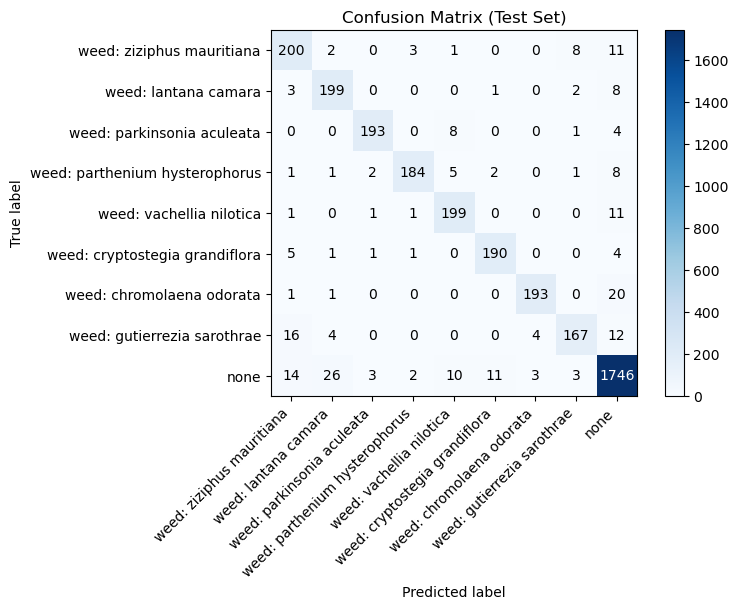

In [70]:
from sklearn.metrics import classification_report, confusion_matrix
import numpy as np
import matplotlib.pyplot as plt
# Force everything to CPU for evaluation

def evaluate_on_loader(model, loader, device):
    model.eval()
    all_preds = []
    all_labels = []

    with torch.no_grad():
        for images, labels in loader:
            images = images.to(device)
            labels = labels.to(device)

            outputs = model(images)
            preds = torch.argmax(outputs, dim=1)

            all_preds.append(preds.cpu().numpy())
            all_labels.append(labels.cpu().numpy())

    all_preds = np.concatenate(all_preds)
    all_labels = np.concatenate(all_labels)
    return all_labels, all_preds
device = torch.device("mps")
resnet50 = resnet50.to(device)

# Run evaluation on test set
y_true, y_pred = evaluate_on_loader(resnet50, test_loader, device)

# Overall accuracy
test_acc = (y_true == y_pred).mean()
print(f"Test accuracy: {test_acc * 100:.2f}%")

# Classification report (per-class precision/recall/F1)
class_names_ordered = [id_to_name[i] for i in sorted(id_to_name.keys())]
print("\nClassification report:")
print(classification_report(y_true, y_pred, target_names=class_names_ordered))

# Confusion matrix


cm = confusion_matrix(y_true, y_pred) 
plt.figure(figsize=(8, 6)) 
plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Blues) 
plt.title("Confusion Matrix (Test Set)") 
plt.colorbar() 
tick_marks = np.arange(len(class_names_ordered)) 
plt.xticks(tick_marks, class_names_ordered, rotation=45, ha="right") 
plt.yticks(tick_marks, class_names_ordered) 
# Add text annotations 
thresh = cm.max() / 2. # Threshold for using white or black text 
for i in range(cm.shape[0]):
    for j in range(cm.shape[1]): 
        plt.text(j, i, format(cm[i, j], 'd'), ha="center", va="center", color="white" if cm[i, j] > thresh else "black") 
plt.tight_layout() 
plt.xlabel("Predicted label") 
plt.ylabel("True label") 
plt.show()



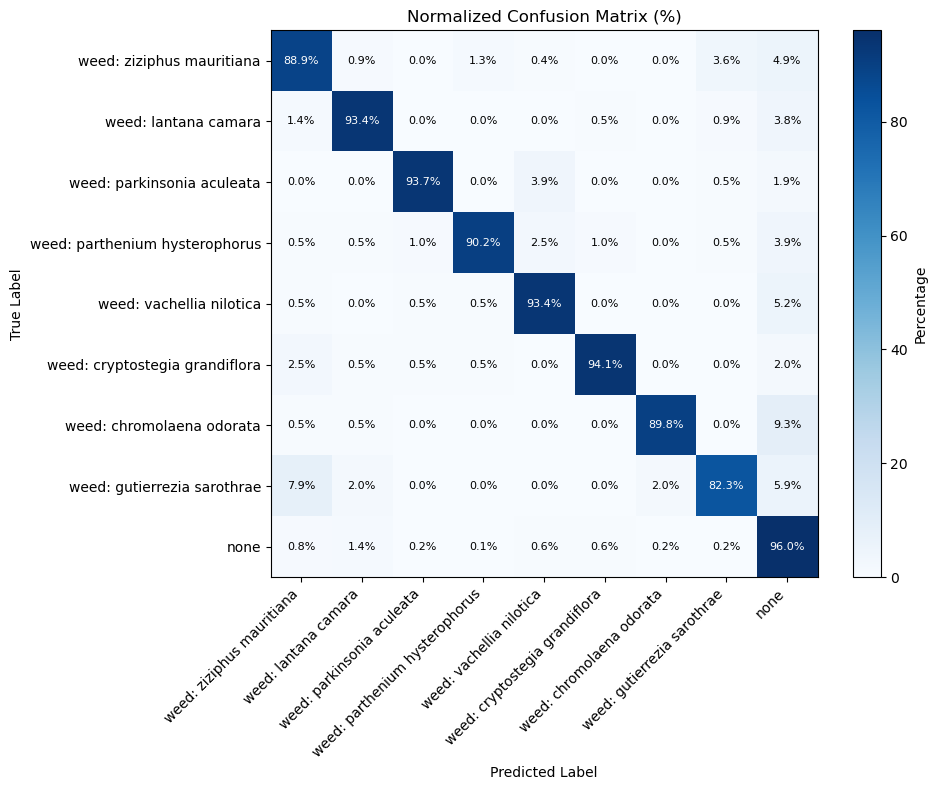

In [73]:
from sklearn.metrics import confusion_matrix
import numpy as np
import matplotlib.pyplot as plt

# Compute confusion matrix
cm = confusion_matrix(y_true, y_pred)

# Normalize row-wise → convert counts to percentages
cm_norm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis] * 100

plt.figure(figsize=(10, 8))
plt.imshow(cm_norm, interpolation='nearest', cmap=plt.cm.Blues)
plt.title("Normalized Confusion Matrix (%)")
plt.colorbar(label="Percentage")

tick_marks = np.arange(len(class_names_ordered))
plt.xticks(tick_marks, class_names_ordered, rotation=45, ha="right")
plt.yticks(tick_marks, class_names_ordered)

# Annotate each cell with percentage values
for i in range(cm_norm.shape[0]):
    for j in range(cm_norm.shape[1]):
        text = f"{cm_norm[i, j]:.1f}%"
        plt.text(j, i, text,
                 ha="center", va="center",
                 color="white" if cm_norm[i, j] > 50 else "black",
                 fontsize=8)

plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.tight_layout()
plt.show()


Class IDs:
  none: 8 -> none
  parthenium: 3 -> weed: parthenium hysterophorus
  lantana: 1 -> weed: lantana camara
  vachellia: 4 -> weed: vachellia nilotica
  parkinsonia: 2 -> weed: parkinsonia aculeata
  cryptostegia: 5 -> weed: cryptostegia grandiflora
Weed -> None misclassifications: 78


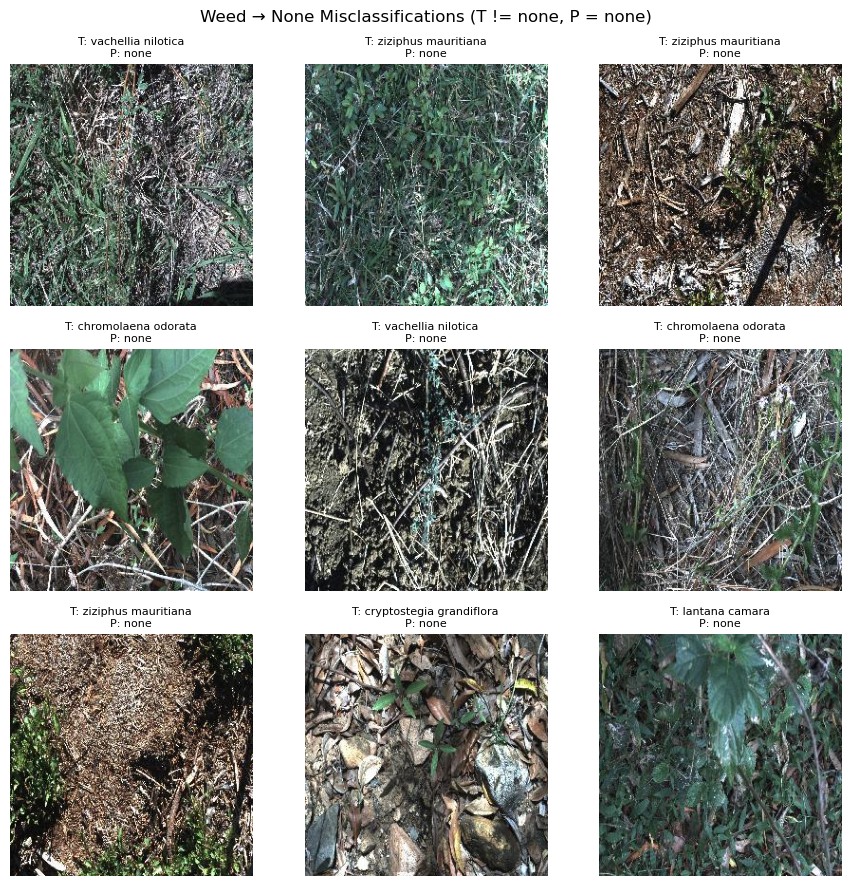

Parthenium <-> Lantana confusions: 1


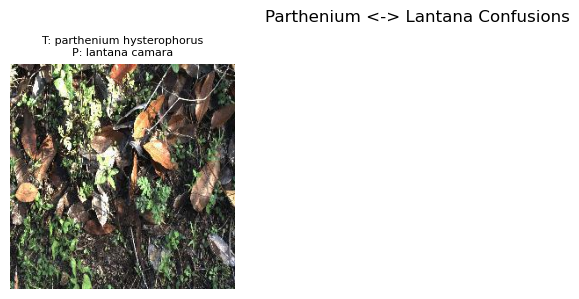

Parthenium <-> Vachellia confusions: 6


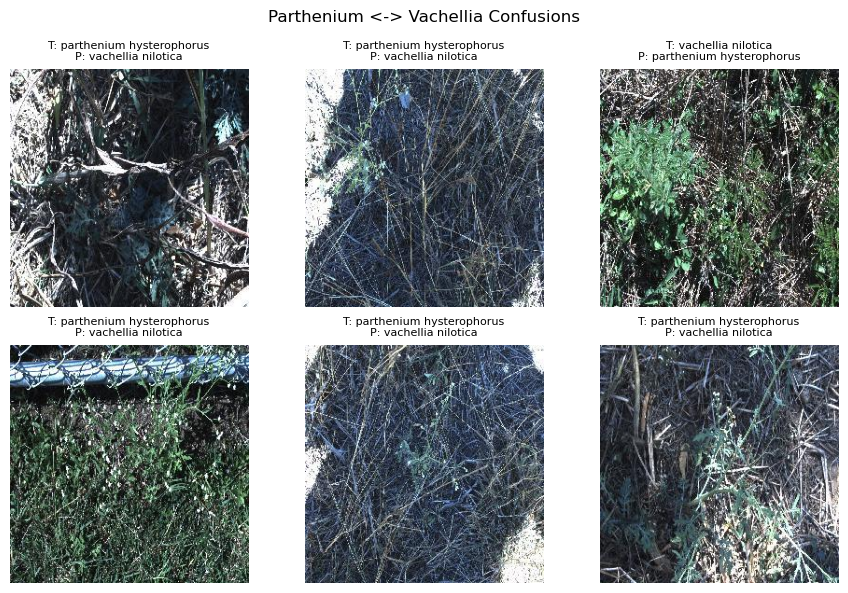

Correct Parkinsonia examples: 193


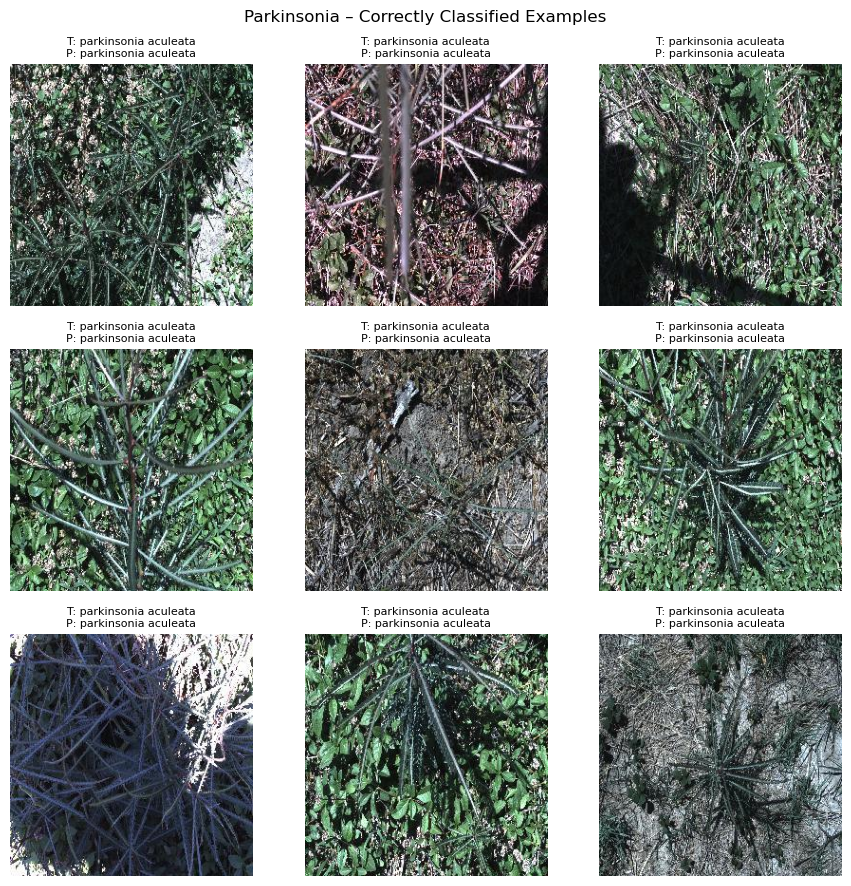

Correct Cryptostegia examples: 190


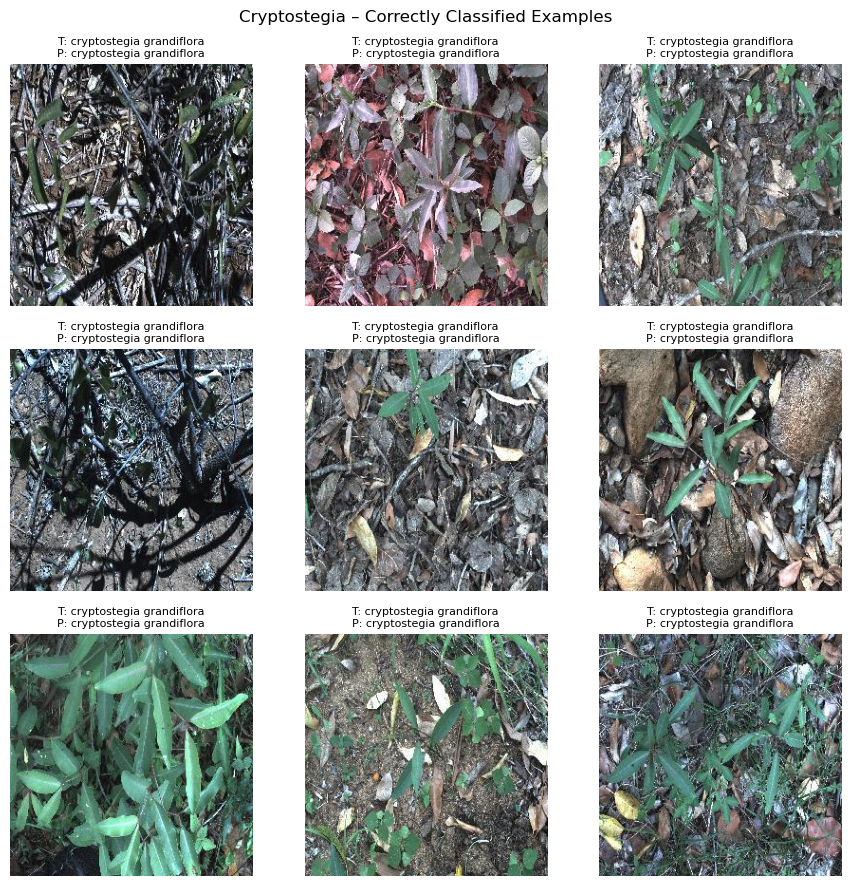

In [72]:
# %% [markdown]
# ### Error Analysis Image Grids (for slides)
# 
# This cell:
# - Finds category IDs for key classes (none, parthenium, lantana, vachellia, parkinsonia, cryptostegia)
# - Builds 3×3 grids for:
#   1) Weed → None misclassifications
#   2) Parthenium ↔ Lantana confusions
#   3) Parthenium ↔ Vachellia confusions
#   4) Correct Parkinsonia examples (easy class)
#   5) Correct Cryptostegia examples (easy class)

# %%
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import random

# Helper: find class id by substring in name
def find_class_id(substring, id_to_name):
    substring = substring.lower()
    for cid, cname in id_to_name.items():
        if substring in cname.lower():
            return cid, cname
    return None, None

none_id, none_name = find_class_id("none", id_to_name)
parth_id, parth_name = find_class_id("parthenium", id_to_name)
lantana_id, lantana_name = find_class_id("lantana", id_to_name)
vach_id, vach_name = find_class_id("vachellia", id_to_name)
park_id, park_name = find_class_id("parkinsonia", id_to_name)
crypt_id, crypt_name = find_class_id("cryptostegia", id_to_name)

print("Class IDs:")
print("  none:", none_id, "->", none_name)
print("  parthenium:", parth_id, "->", parth_name)
print("  lantana:", lantana_id, "->", lantana_name)
print("  vachellia:", vach_id, "->", vach_name)
print("  parkinsonia:", park_id, "->", park_name)
print("  cryptostegia:", crypt_id, "->", crypt_name)

# Safety check
assert none_id is not None
assert parth_id is not None and lantana_id is not None
assert vach_id is not None and park_id is not None and crypt_id is not None

# Helper: nice short label for slide titles
def short_name(full_name):
    # "weed: parthenium hysterophorus" -> "parthenium hysterophorus"
    return full_name.split(":", 1)[-1].strip()

# Generic grid plotter
def plot_grid(df_subset, title, max_images=9):
    if len(df_subset) == 0:
        print(f"[WARN] No examples found for: {title}")
        return

    # Sample up to max_images
    df_sample = df_subset.sample(min(len(df_subset), max_images), random_state=42)
    n = len(df_sample)

    cols = 3
    rows = int(np.ceil(n / cols))

    plt.figure(figsize=(cols * 3, rows * 3))
    for i, (_, row) in enumerate(df_sample.iterrows()):
        img_path = IMAGES_ROOT / row["file_name"]
        try:
            img = Image.open(img_path).convert("RGB")
        except Exception as e:
            print(f"[WARN] Could not open {img_path}: {e}")
            continue

        plt.subplot(rows, cols, i + 1)
        plt.imshow(img)
        plt.axis("off")

        true_label = int(row["y_true"])
        pred_label = int(row["y_pred"])

        true_name = short_name(id_to_name[true_label])
        pred_name = short_name(id_to_name[pred_label])

        plt.title(f"T: {true_name}\nP: {pred_name}", fontsize=8)

    plt.suptitle(title, fontsize=12)
    plt.tight_layout()
    plt.show()


# 1) Weed → None misclassifications
#    True class is NOT none, predicted class IS none
weed_to_none = df_test[(df_test["y_true"] != none_id) & (df_test["y_pred"] == none_id)]
print("Weed -> None misclassifications:", len(weed_to_none))
plot_grid(weed_to_none, title="Weed → None Misclassifications (T != none, P = none)", max_images=9)


# 2) Parthenium ↔ Lantana confusions
#    (a) true parthenium, predicted lantana
#    (b) true lantana, predicted parthenium
parth_to_lantana = df_test[(df_test["y_true"] == parth_id) & (df_test["y_pred"] == lantana_id)]
lantana_to_parth = df_test[(df_test["y_true"] == lantana_id) & (df_test["y_pred"] == parth_id)]

parth_lantana_confusions = pd.concat([parth_to_lantana, lantana_to_parth], ignore_index=True)
print("Parthenium <-> Lantana confusions:", len(parth_lantana_confusions))
plot_grid(parth_lantana_confusions, title="Parthenium <-> Lantana Confusions", max_images=9)


# 3) Parthenium ↔ Vachellia confusions
parth_to_vach = df_test[(df_test["y_true"] == parth_id) & (df_test["y_pred"] == vach_id)]
vach_to_parth = df_test[(df_test["y_true"] == vach_id) & (df_test["y_pred"] == parth_id)]

parth_vach_confusions = pd.concat([parth_to_vach, vach_to_parth], ignore_index=True)
print("Parthenium <-> Vachellia confusions:", len(parth_vach_confusions))
plot_grid(parth_vach_confusions, title="Parthenium <-> Vachellia Confusions", max_images=9)


# 4) Correct Parkinsonia examples (easy class)
park_correct = df_test[(df_test["y_true"] == park_id) & (df_test["y_pred"] == park_id)]
print("Correct Parkinsonia examples:", len(park_correct))
plot_grid(park_correct, title="Parkinsonia – Correctly Classified Examples", max_images=9)


# 5) Correct Cryptostegia examples (easy class)
crypt_correct = df_test[(df_test["y_true"] == crypt_id) & (df_test["y_pred"] == crypt_id)]
print("Correct Cryptostegia examples:", len(crypt_correct))
plot_grid(crypt_correct, title="Cryptostegia – Correctly Classified Examples", max_images=9)

In [74]:
import matplotlib.pyplot as plt
from PIL import Image

# ---- CONFIG ----
parth_name = "weed: parthenium hysterophorus"
guti_name  = "weed: gutierrezia sarothrae"

# Filter rows for each weed class
parth_rows = df_test[df_test['category_name'] == parth_name].head(2)
guti_rows  = df_test[df_test['category_name'] == guti_name].head(2)

# Collect file paths
image_paths = [
    root_dir + "/" + parth_rows.iloc[0]['file_name'],
    root_dir + "/" + parth_rows.iloc[1]['file_name'],
    root_dir + "/" + guti_rows.iloc[0]['file_name'],
    root_dir + "/" + guti_rows.iloc[1]['file_name']
]

titles = [
    "Parthenium (1)",
    "Parthenium (2)",
    "Gutierrezia (1)",
    "Gutierrezia (2)"
]

# ---- PLOT ----
plt.figure(figsize=(10, 10))

for i, (path, title) in enumerate(zip(image_paths, titles)):
    img = Image.open(path)
    plt.subplot(2, 2, i+1)
    plt.imshow(img)
    plt.title(title)
    plt.axis("off")

plt.tight_layout()
plt.show()



KeyError: 'category_name'

### Saving the trained ResNet50 model

For reproducibility and later use (e.g., Grad-CAM visualizations, further experiments), I will save the final fine-tuned ResNet50 weights to disk.


In [28]:

# Save the fine-tuned ResNet50 weights
MODEL_PATH = "resnet50_weedai_best.pth"
torch.save(resnet50.state_dict(), MODEL_PATH)
print(f"Saved best ResNet50 model to: {MODEL_PATH}")



Saved best ResNet50 model to: resnet50_weedai_best.pth


## ResNet50 Training Summary and Next Steps

My ResNet50 fine-tuning run behaved very well:

- Training accuracy went from ~79% to ~97% over 11 epochs.
- Validation accuracy steadily improved up to ~93–94%.
- Validation loss decreased until around epoch 5, then started to flatten / slightly bounce.
- Early stopping triggered at epoch 11, and the model weights were restored to the **best validation-loss epoch**.

Final test performance:

- **Test accuracy** ≈ 93.5%.
- **Macro F1-score** ≈ 0.92.
- **Weighted F1-score** ≈ 0.93.
- Confusion matrix shows strongest performance on the `none` class and good performance on the 8 weed classes, with some confusion between certain weeds and `none` or visually similar species.

Next, I will:

1. Plot the **training vs validation loss and accuracy** across epochs to visualize convergence and check for overfitting signs.
2. Identify which epoch gave the **best validation loss** (early stopping target).
3. (Optional) Decide whether I need a second run with a different random split for robustness, or just discuss this as a limitation / future work.


Best epoch (by val loss): 5
  best val loss = 0.2094
  val acc at best epoch = 93.48%


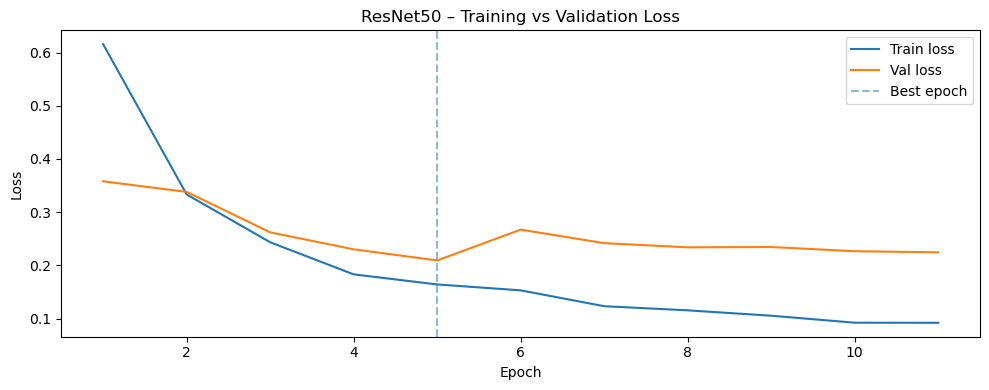

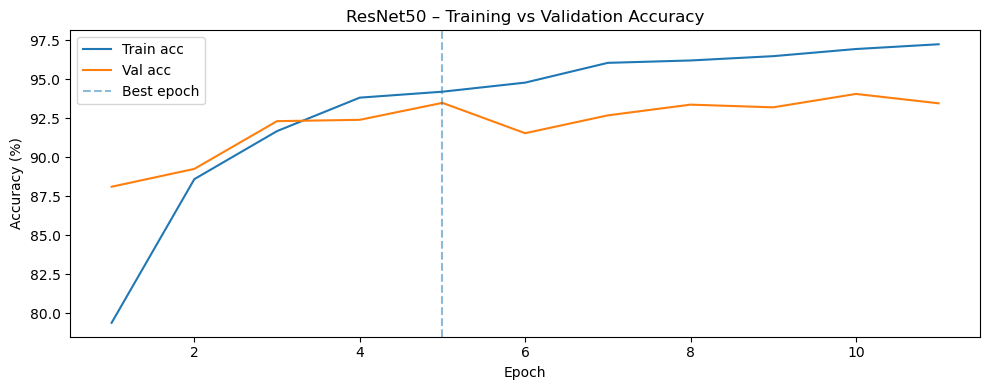

In [29]:
# Unpack history lists: [(loss, acc), ...] --> separate lists
train_losses = [x[0] for x in train_history_50]
train_accs   = [x[1] for x in train_history_50]
val_losses   = [x[0] for x in val_history_50]
val_accs     = [x[1] for x in val_history_50]

epochs_run = np.arange(1, len(train_losses) + 1)

# Find best epoch by lowest validation loss
best_epoch_idx = int(np.argmin(val_losses))          # 0-based index
best_epoch = epochs_run[best_epoch_idx]              # 1-based epoch number
best_val_loss = val_losses[best_epoch_idx]
best_val_acc  = val_accs[best_epoch_idx]

print(f"Best epoch (by val loss): {best_epoch}")
print(f"  best val loss = {best_val_loss:.4f}")
print(f"  val acc at best epoch = {best_val_acc*100:.2f}%")

# Plot loss
plt.figure(figsize=(10,4))
plt.plot(epochs_run, train_losses, label="Train loss")
plt.plot(epochs_run, val_losses, label="Val loss")
plt.axvline(best_epoch, linestyle="--", alpha=0.5, label="Best epoch")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title("ResNet50 – Training vs Validation Loss")
plt.legend()
plt.tight_layout()
plt.show()

# Plot accuracy
plt.figure(figsize=(10,4))
plt.plot(epochs_run, [a*100 for a in train_accs], label="Train acc")
plt.plot(epochs_run, [a*100 for a in val_accs], label="Val acc")
plt.axvline(best_epoch, linestyle="--", alpha=0.5, label="Best epoch")
plt.xlabel("Epoch")
plt.ylabel("Accuracy (%)")
plt.title("ResNet50 – Training vs Validation Accuracy")
plt.legend()
plt.tight_layout()
plt.show()

In [30]:
"""
FULL EXPERIMENT RE-RUN WITH A DIFFERENT RANDOM SEED
---------------------------------------------------
This cell:
1. Changes the RANDOM_SEED
2. Regenerates a stratified 60/20/20 split
3. Rebuilds the DataLoaders
4. Rebuilds + trains a fresh ResNet50 model with early stopping
5. Evaluates on test set
6. Prints comparison with previous run

NOTE:
- Training will take ~30–40 minutes again.
- This reuses all functions already defined earlier.
"""

import numpy as np
import torch
from sklearn.model_selection import train_test_split
import copy
from torchvision import models
import torch.nn as nn
import torch.optim as optim

NEW_SEED = 123  
print(f"\n Running second experiment with seed = {NEW_SEED}\n")

# -------------------------------------------------------------------
# 1) Apply new seed globally
# -------------------------------------------------------------------
torch.manual_seed(NEW_SEED)
np.random.seed(NEW_SEED)
random.seed(NEW_SEED)

# -------------------------------------------------------------------
# 2) Re-generate stratified 60/20/20 splits
# -------------------------------------------------------------------
labels = df["category_id"].values
indices = np.arange(len(df))

# Train vs temp
train_idx2, temp_idx2, y_train2, y_temp2 = train_test_split(
    indices,
    labels,
    test_size=0.40,
    stratify=labels,
    random_state=NEW_SEED
)

# Val vs test
val_idx2, test_idx2, y_val2, y_test2 = train_test_split(
    temp_idx2,
    y_temp2,
    test_size=0.50,
    stratify=y_temp2,
    random_state=NEW_SEED
)

print(f"New split sizes: train={len(train_idx2)}, val={len(val_idx2)}, test={len(test_idx2)}")

# Build new datasets
train_ds2 = WeedDataset(df.iloc[train_idx2], IMAGES_ROOT, transform=train_transform)
val_ds2   = WeedDataset(df.iloc[val_idx2],   IMAGES_ROOT, transform=eval_transform)
test_ds2  = WeedDataset(df.iloc[test_idx2],  IMAGES_ROOT, transform=eval_transform)

train_loader2 = DataLoader(train_ds2, batch_size=BATCH_SIZE, shuffle=True, num_workers=0)
val_loader2   = DataLoader(val_ds2,   batch_size=BATCH_SIZE, shuffle=False, num_workers=0)
test_loader2  = DataLoader(test_ds2,  batch_size=BATCH_SIZE, shuffle=False, num_workers=0)

# -------------------------------------------------------------------
# 3) Build a *new* ResNet50 model
# -------------------------------------------------------------------
resnet50_b = models.resnet50(pretrained=True)
in_features = resnet50_b.fc.in_features
resnet50_b.fc = nn.Linear(in_features, NUM_CLASSES)
resnet50_b = resnet50_b.to(device)

criterion_b = nn.CrossEntropyLoss()
optimizer_b = optim.Adam(resnet50_b.parameters(), lr=1e-4)

# Early stopping
max_epochs = 30
patience = 5
best_val_loss_b = float("inf")
best_state_b = copy.deepcopy(resnet50_b.state_dict())
patience_counter = 0

train_hist_b = []
val_hist_b = []

# -------------------------------------------------------------------
# 4) Training loop
# -------------------------------------------------------------------
for epoch in range(1, max_epochs + 1):
    print(f"Epoch {epoch}/{max_epochs}")

    train_loss_b, train_acc_b = train_one_epoch(
        resnet50_b, train_loader2, optimizer_b, criterion_b, device
    )
    val_loss_b, val_acc_b = evaluate_one_epoch(
        resnet50_b, val_loader2, criterion_b, device
    )

    train_hist_b.append((train_loss_b, train_acc_b))
    val_hist_b.append((val_loss_b, val_acc_b))

    print(f"  Train loss: {train_loss_b:.4f} | Train acc: {train_acc_b*100:.2f}%")
    print(f"  Val   loss: {val_loss_b:.4f} | Val   acc:  {val_acc_b*100:.2f}%")

    if val_loss_b < best_val_loss_b:
        best_val_loss_b = val_loss_b
        best_state_b = copy.deepcopy(resnet50_b.state_dict())
        patience_counter = 0
        print("  Improved val loss.")
    else:
        patience_counter += 1
        print(f"  No improvement for {patience_counter} epoch(s).")
        if patience_counter > patience:
            print("  ⏹ Early stopping.")
            break

# Restore best weights
resnet50_b.load_state_dict(best_state_b)
print("\nLoaded best model from second run.\n")

# -------------------------------------------------------------------
# 5) Evaluate on test set
# -------------------------------------------------------------------
y_true2, y_pred2 = evaluate_on_loader(resnet50_b, test_loader2, device)
test_acc2 = (y_true2 == y_pred2).mean()

print("SECOND RUN RESULTS")
print("---------------------")
print(f"Test accuracy (seed={NEW_SEED}): {test_acc2*100:.2f}%")

# Also print macro F1, weighted F1
from sklearn.metrics import classification_report
print("\nClassification report:")
print(classification_report(y_true2, y_pred2, target_names=class_names_ordered))

# -------------------------------------------------------------------
# 6) Compare Run #1 vs Run #2
# -------------------------------------------------------------------
print("\n================ ROBUSTNESS CHECK ================\n")
print(f"Original run test accuracy:     {test_acc*100:.2f}%")
print(f"New run (seed={NEW_SEED}) test accuracy: {test_acc2*100:.2f}%")
print("\nDifference:", round((test_acc2 - test_acc) * 100, 2), "%")
print("\n==================================================\n")



 Running second experiment with seed = 123

New split sizes: train=10495, val=3498, test=3499


/Library/anaconda3/envs/rs-ml/lib/python3.11/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/Library/anaconda3/envs/rs-ml/lib/python3.11/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/30
  Train loss: 0.6147 | Train acc: 79.14%
  Val   loss: 0.3235 | Val   acc:  89.08%
  Improved val loss.
Epoch 2/30
  Train loss: 0.3115 | Train acc: 89.57%
  Val   loss: 0.2733 | Val   acc:  91.02%
  Improved val loss.
Epoch 3/30
  Train loss: 0.2427 | Train acc: 92.00%
  Val   loss: 0.2314 | Val   acc:  92.11%
  Improved val loss.
Epoch 4/30
  Train loss: 0.1961 | Train acc: 93.48%
  Val   loss: 0.2249 | Val   acc:  92.91%
  Improved val loss.
Epoch 5/30
  Train loss: 0.1596 | Train acc: 94.48%
  Val   loss: 0.1968 | Val   acc:  94.34%
  Improved val loss.
Epoch 6/30
  Train loss: 0.1405 | Train acc: 95.34%
  Val   loss: 0.1907 | Val   acc:  94.11%
  Improved val loss.
Epoch 7/30
  Train loss: 0.1191 | Train acc: 96.05%
  Val   loss: 0.2060 | Val   acc:  93.51%
  No improvement for 1 epoch(s).
Epoch 8/30
  Train loss: 0.1145 | Train acc: 96.22%
  Val   loss: 0.1716 | Val   acc:  94.40%
  Improved val loss.
Epoch 9/30
  Train loss: 0.1030 | Train acc: 96.46%
  Val   loss: 0.

## 4. Training Strategy: Comparison with the Original DeepWeeds Implementation

The original DeepWeeds study (Olsen et al., 2019) trained ResNet-50 and Inception-v3 models using a
substantially heavier training protocol than what is feasible under the computational and time constraints
of this project. To contextualize the methodological differences, this section contrasts both approaches
and justifies the training decisions taken in this work.

### 4.1 Original DeepWeeds Training Pipeline (Olsen et al., 2019)

The DeepWeeds paper employed a **from-scratch** training strategy:

- **Models:** ResNet-50 and Inception-v3.
- **Initialization:** Random initialization (no ImageNet pretraining).
- **Cross-validation:** 5-fold stratified cross-validation.
- **Epochs:** 200 epochs per fold (i.e., 1000 total epochs).
- **Hardware:** High-performance NVIDIA GPU, optimized inference via TensorRT.

Training from scratch requires many epochs because the models must first learn fundamental visual
representations such as edges, textures, and color gradients before learning weed-specific patterns. This
is computationally expensive but justified when training on large datasets with dedicated GPU hardware.

### 4.2 Training Strategy in This Work

In contrast, this project uses a **modern transfer-learning approach**, which is the standard practice in
contemporary computer vision:

- **Model:** ResNet-50 (PyTorch implementation).
- **Initialization:** ImageNet-pretrained weights.
- **Data split:** One stratified 60/20/20 train-validation-test split.
- **Epochs:** Early stopping within ~10–15 epochs.
- **Hardware:** Apple M1 Pro with PyTorch MPS backend.

ImageNet-pretrained models have already learned general-purpose visual features (edges, corners, texture
patterns, color transitions). Fine-tuning such a model on DeepWeeds accelerates convergence dramatically,
reduces compute requirements by an order of magnitude, and often yields performance competitive with or
superior to training from scratch.

### 4.3 Why the Approaches Differ

Running the full DeepWeeds pipeline (5 folds × 200 epochs per fold) on an M1 Pro would require an estimated:

- **~3 minutes per epoch × 1000 epochs ≈ 50–60 hours**,  
  excluding overhead such as augmentations, logging, and retries.

This was not practical within the project constraints. A single stratified split with early stopping
provides a computationally efficient alternative while still maintaining rigorous evaluation standards.

### 4.4 Validity of the Chosen Strategy

Despite differing evaluation protocols, the transfer-learning approach used here yields strong and stable
results:

- Test accuracy: **93.48%** (seed 42) and **93.60%** (seed 123).
- Difference across seeds: **0.11%**, indicating high robustness.
- Macro F1: approximately **0.92**, demonstrating balanced performance across classes.

The large independent test set (~3,499 images) provides a meaningful estimate of generalization
performance. Repeating the entire pipeline with a different random seed further validates that the model’s
behavior is not sensitive to a particular data split.

### 4.5 Interpretation

While the results cannot be directly compared to the 5-fold CV metrics in the DeepWeeds paper, they show
that a modern transfer-learning workflow can achieve competitive performance with drastically reduced
training time. This supports the practicality of using pretrained architectures for rapid prototyping and
deployment in applied remote sensing and agricultural monitoring contexts.



## 5. Grad-CAM: Visualizing What the Model Looks At

In this section, I want to understand **where** my ResNet-50 model is looking when it makes a decision.

I will use **Grad-CAM** (Gradient-weighted Class Activation Mapping) to show heatmaps on the image:

- Red/yellow = regions that strongly influenced the prediction.
- Blue = regions that were less important.

My goal is to:
- Pick one **correctly classified** and one **misclassified** test image for:
  - `weed: parthenium hysterophorus`
  - `weed: lantana camara`
- Generate Grad-CAM heatmaps for each of these images.
- Compare:
  - In correct cases, does the model focus on the weed?
  - In wrong cases, is it focusing on background / noise?

First, I will:
1. Reload my **best ResNet-50 model** (from the saved `.pth` file).
2. Run it over the **test set** again to collect:
   - true label
   - predicted label
   - whether each image was correct or misclassified
3. Store this information in a `test_results` DataFrame. This will make it easy to pick example images later.


In [31]:
import torch
import torch.nn as nn
from torchvision import models

# 1) Reload the best ResNet-50 model from disk
#    TODO: change this path to match the filename you actually saved earlier.
BEST_MODEL_PATH = "/Users/wangtiles/Applcns_of_ML_remote_sensing/Weed_Detection_Project/resnet50_weedai_best.pth"  

# Create a fresh ResNet-50 with ImageNet weights, then replace the final layer (same as before)
resnet50 = models.resnet50(weights=models.ResNet50_Weights.IMAGENET1K_V1)
num_features = resnet50.fc.in_features
resnet50.fc = nn.Linear(num_features, 9)  # 9 classes (8 weeds + none)

resnet50.load_state_dict(torch.load(BEST_MODEL_PATH, map_location=device))
resnet50 = resnet50.to(device)
resnet50.eval()

print("Loaded best ResNet-50 weights from:", BEST_MODEL_PATH)

# 2) Re-run on the test set to collect predictions
import numpy as np
import pandas as pd

# Make sure test_df is aligned with test_loader (we used shuffle=False when creating it)
test_df = test_df.reset_index(drop=True)

all_preds = []
all_probs = []
all_true = []

with torch.no_grad():
    idx = 0  # index into test_df
    for images, labels in test_loader:
        images = images.to(device)
        labels = labels.to(device)

        outputs = resnet50(images)                     # shape: (batch_size, 9)
        probs = torch.softmax(outputs, dim=1)          # convert logits -> probabilities
        preds = torch.argmax(probs, dim=1)             # predicted class indices

        batch_size = labels.size(0)

        all_true.extend(labels.cpu().numpy().tolist())
        all_preds.extend(preds.cpu().numpy().tolist())
        all_probs.extend(probs.max(dim=1).values.cpu().numpy().tolist())

        idx += batch_size

# 3) Attach predictions back to test_df
test_results = test_df.copy()
test_results["true_label"] = all_true
test_results["pred_label"] = all_preds
test_results["pred_confidence"] = all_probs
test_results["correct"] = test_results["true_label"] == test_results["pred_label"]

print("test_results head:")
display(test_results.head())

print("Correct vs misclassified counts:")
display(test_results["correct"].value_counts())


Loaded best ResNet-50 weights from: /Users/wangtiles/Applcns_of_ML_remote_sensing/Weed_Detection_Project/resnet50_weedai_best.pth
test_results head:


,image_id,file_name,category_id,class_name,true_label,pred_label,pred_confidence,correct
0,10894,images/9bd2161125746edb3d7f.jpg,8,none,8,8,0.906206,True
1,14994,images/e092ba6ef394a27eabbf.jpg,8,none,8,8,0.997175,True
2,2356,images/5bf30f7302e325bdb65c.jpg,1,weed: lantana camara,1,1,0.999990,True
3,9766,images/1d8befc8a3c071b8aded.jpg,8,none,8,8,0.948226,True
4,17404,images/7610d255d90e67bcc9a3.jpg,8,none,8,8,0.999777,True


Correct vs misclassified counts:


correct
True     3271
False     228
Name: count, dtype: int64

### 5.1 Grad-CAM implementation (simple version)

Below I implement a very small Grad-CAM helper:

- I hook into the **last convolutional layer** of ResNet-50 (`layer4[-1]`).
- When I run a forward pass, I save the **activations** (feature maps).
- When I run `.backward()` for a chosen class score, I save the **gradients** at that layer.
- Grad-CAM heatmap is computed as:

  1. Average the gradients over the spatial dimensions → this gives a weight for each channel.
  2. Take a weighted sum of the feature maps using those weights.
  3. Apply ReLU and normalize to [0, 1].

This is the standard Grad-CAM formula but written in a simple, explicit way.


In [39]:
# %%
import torch
import torch.nn.functional as F
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image

class SimpleGradCAM:
    """
    Very small Grad-CAM helper for ResNet-50.

    Usage:
        gradcam = SimpleGradCAM(resnet50, target_layer=resnet50.layer4[-1])
        cam, pred_class = gradcam(image_tensor)
    """
    def __init__(self, model, target_layer):
        self.model = model
        self.target_layer = target_layer

        self.gradients = None
        self.activations = None

        # Register hooks
        self._register_hooks()

    def _register_hooks(self):
        # Forward hook: saves the activations (feature maps)
        def forward_hook(module, input, output):
            self.activations = output.detach()

        # Backward hook: saves the gradients
        def backward_hook(module, grad_input, grad_output):
            # grad_output is a tuple; we care about grad_output[0]
            self.gradients = grad_output[0].detach()

        self.target_layer.register_forward_hook(forward_hook)
        self.target_layer.register_backward_hook(backward_hook)

    def __call__(self, input_tensor, target_class=None):
        """
        Compute Grad-CAM heatmap for a single image.

        input_tensor: shape (1, C, H, W)
        target_class: integer class index. If None, uses the model's predicted class.
        """
        self.model.zero_grad()

        # Forward pass
        output = self.model(input_tensor)  # shape: (1, num_classes)
        if target_class is None:
            target_class = output.argmax(dim=1).item()

        # Take the scalar score for the target class
        target_score = output[0, target_class]

        # Backward: compute gradients w.r.t. target_score
        target_score.backward()

        # Now self.gradients and self.activations are filled
        # gradients: (1, C, H, W)
        # activations: (1, C, H, W)
        gradients = self.gradients[0]   # (C, H, W)
        activations = self.activations[0]

        # IMPORTANT FIX: create cam on the SAME DEVICE as activations
        cam = torch.zeros(activations.shape[1:], dtype=activations.dtype, device=activations.device)

        # Global-average-pool the gradients over H and W -> weights per channel
        weights = gradients.mean(dim=(1, 2))  # (C,)

        # Weighted sum of activations
        for i, w in enumerate(weights):
            cam += w * activations[i]

        # ReLU: keep only positive contributions
        cam = F.relu(cam)

        # Normalize to [0, 1]
        cam -= cam.min()
        if cam.max() > 0:
            cam /= cam.max()

        # Move to CPU for numpy + plotting
        cam_np = cam.detach().cpu().numpy()
        return cam_np, target_class

# Re-create the Grad-CAM object after redefining the class
gradcam = SimpleGradCAM(resnet50, target_layer=resnet50.layer4[-1])
print("Grad-CAM ready (device-safe).")


Grad-CAM ready (device-safe).


### 5.2 Helper to visualize Grad-CAM for a given test image

Now I define a helper function that:

1. Takes a row from `test_results` (so it has `file_name`, `true_label`, `pred_label`, etc.).
2. Loads the corresponding image from disk.
3. Applies the same `eval_transform` used during testing.
4. Runs Grad-CAM to get a heatmap for:
   - Either the **predicted class**, or
   - A chosen **target class**.
5. Overlays the heatmap on top of the original RGB image.

I will use this helper for specific examples from:
- `weed: parthenium hysterophorus`
- `weed: lantana camara`


In [40]:
# Make sure we know how to go from label ID to class name.
# Earlier we used coco["categories"], each with fields: id, name, etc.
id_to_name = {cat["id"]: cat["name"] for cat in coco["categories"]}

def show_gradcam_for_row(row, model, gradcam, root_dir, eval_transform, use_true_class=False, title_prefix=""):
    """
    Visualize Grad-CAM for a single test image given a row from test_results.

    Parameters
    ----------
    row : pd.Series
        A row from test_results with at least 'file_name', 'true_label', 'pred_label'.
    model : nn.Module
        The trained ResNet-50 model (already on device, in eval mode).
    gradcam : SimpleGradCAM
        The Grad-CAM helper object.
    root_dir : Path
        Folder where 'images/' lives and where file_name is relative to.
    eval_transform : torchvision.transforms
        The transform used for validation/testing.
    use_true_class : bool
        If True, compute Grad-CAM w.r.t. the true label.
        If False, compute w.r.t. the predicted label.
    title_prefix : str
        Extra text to prepend in the plot title.
    """
    file_name = row["file_name"]
    true_label = int(row["true_label"])
    pred_label = int(row["pred_label"])

    img_path = root_dir / file_name

    # 1) Load original RGB image
    pil_img = Image.open(img_path).convert("RGB")

    # 2) Prepare tensor for the model
    input_tensor = eval_transform(pil_img).unsqueeze(0).to(device)

    # 3) Choose which class to explain
    if use_true_class:
        target_class = true_label
        class_for_cam = "true"
    else:
        target_class = pred_label
        class_for_cam = "predicted"

    # 4) Run Grad-CAM
    cam, used_class = gradcam(input_tensor, target_class=target_class)

    # 5) Resize CAM to image size
    cam_resized = Image.fromarray((cam * 255).astype(np.uint8)).resize(pil_img.size, resample=Image.BILINEAR)
    cam_resized = np.array(cam_resized) / 255.0  # back to [0,1] float

    # 6) Plot original image and overlay
    plt.figure(figsize=(8, 4))

    # Left: original
    plt.subplot(1, 2, 1)
    plt.imshow(pil_img)
    plt.axis("off")
    plt.title(f"{title_prefix}\nOriginal\nTrue: {id_to_name[true_label]}\nPred: {id_to_name[pred_label]}",
              fontsize=8)

    # Right: overlay
    plt.subplot(1, 2, 2)
    plt.imshow(pil_img)
    plt.imshow(cam_resized, cmap="jet", alpha=0.4)  # heatmap overlay
    plt.axis("off")
    plt.title(f"{title_prefix}\nGrad-CAM (class={class_for_cam})\nTrue: {id_to_name[true_label]}\nPred: {id_to_name[pred_label]}",
              fontsize=8)

    plt.tight_layout()
    plt.show()


### 5.3 Selecting correct and misclassified examples for Parthenium and Lantana

Now I choose specific test images to visualize:

- For each of:
  - `weed: parthenium hysterophorus`
  - `weed: lantana camara`

I will:
- Find the first **correctly classified** test image.
- Find the first **misclassified** test image (true label = that class, predicted label ≠ that class).

Then I will generate Grad-CAM visualizations for those four images.


In [41]:
# Make sure test_results has class_name column (inherited from df)
# If not, join it back from df using file_name.
if "class_name" not in test_results.columns:
    test_results = test_results.merge(
        df[["file_name", "class_name"]],
        on="file_name",
        how="left"
    )

# Class names we care about
parth_name = "weed: parthenium hysterophorus"
lantana_name = "weed: lantana camara"

def pick_examples_for_class(class_name):
    """
    Return (correct_row, mis_row) for the given class.
    correct_row: first correctly classified test sample of this class.
    mis_row: first misclassified test sample of this class.
    """
    subset = test_results[test_results["class_name"] == class_name]

    correct = subset[subset["correct"] == True]
    mis = subset[subset["correct"] == False]

    correct_row = correct.iloc[0] if len(correct) > 0 else None
    mis_row = mis.iloc[0] if len(mis) > 0 else None

    return correct_row, mis_row

parth_correct, parth_mis = pick_examples_for_class(parth_name)
lantana_correct, lantana_mis = pick_examples_for_class(lantana_name)

print("Parthenium - correct example found:", parth_correct is not None)
print("Parthenium - misclassified example found:", parth_mis is not None)
print("Lantana    - correct example found:", lantana_correct is not None)
print("Lantana    - misclassified example found:", lantana_mis is not None)


Parthenium - correct example found: True
Parthenium - misclassified example found: True
Lantana    - correct example found: True
Lantana    - misclassified example found: True


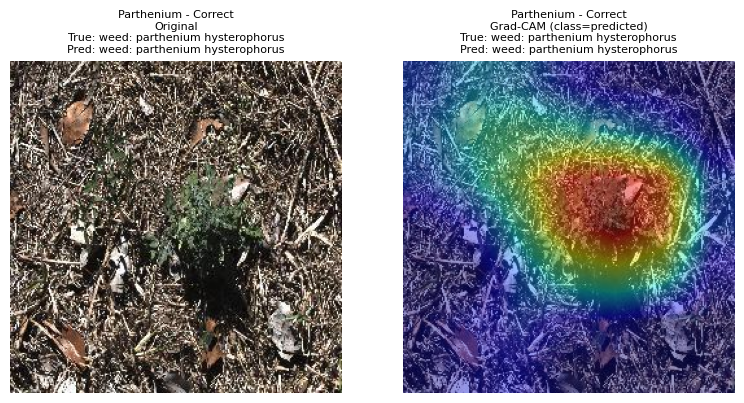

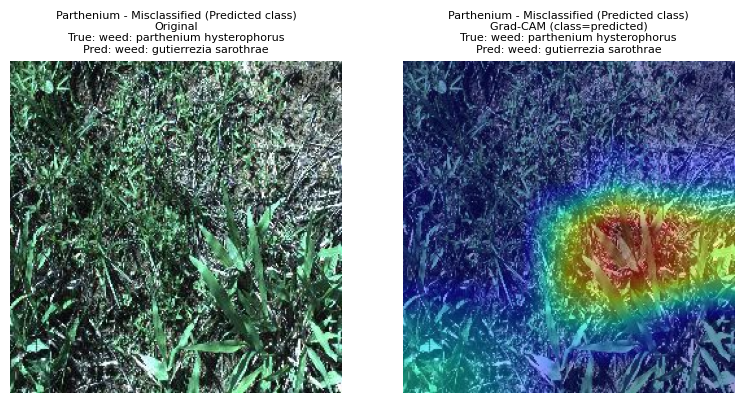

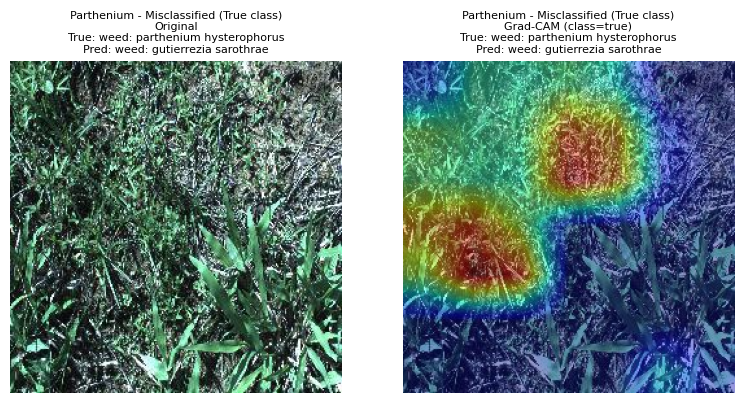

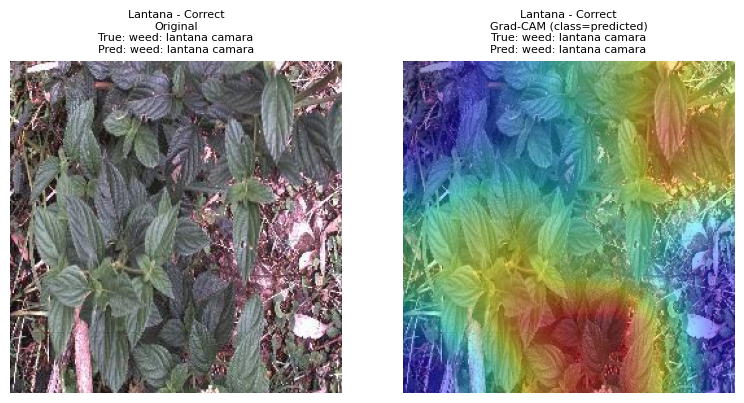

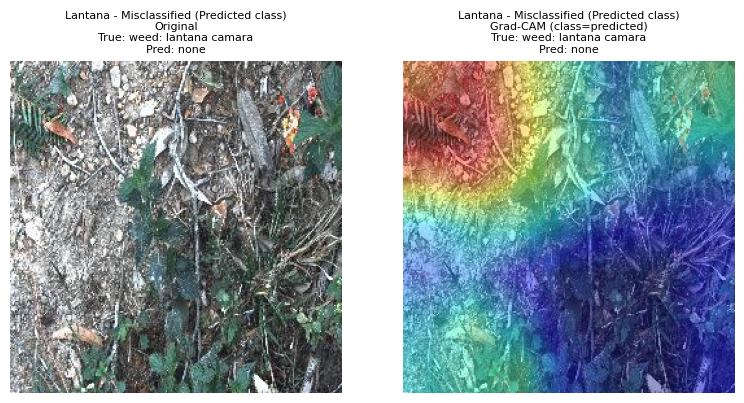

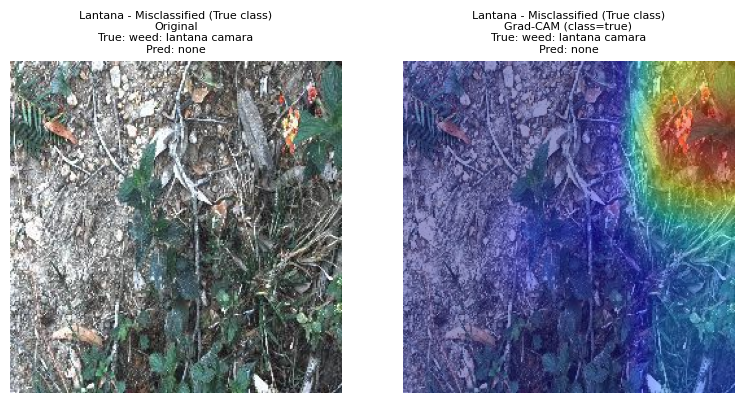

In [42]:
# Parthenium - correct example
if parth_correct is not None:
    show_gradcam_for_row(
        row=parth_correct,
        model=resnet50,
        gradcam=gradcam,
        root_dir=IMAGES_ROOT,
        eval_transform=eval_transform,
        use_true_class=False,   # explain the predicted class (which equals true here)
        title_prefix="Parthenium - Correct"
    )

# Parthenium - misclassified example
if parth_mis is not None:
    show_gradcam_for_row(
        row=parth_mis,
        model=resnet50,
        gradcam=gradcam,
        root_dir=IMAGES_ROOT,
        eval_transform=eval_transform,
        use_true_class=False,   # first show how it explains its wrong prediction
        title_prefix="Parthenium - Misclassified (Predicted class)"
    )

    # Optional: also show Grad-CAM w.r.t. the TRUE class (even though it predicted something else)
    show_gradcam_for_row(
        row=parth_mis,
        model=resnet50,
        gradcam=gradcam,
        root_dir=IMAGES_ROOT,
        eval_transform=eval_transform,
        use_true_class=True,
        title_prefix="Parthenium - Misclassified (True class)"
    )

# Lantana - correct example
if lantana_correct is not None:
    show_gradcam_for_row(
        row=lantana_correct,
        model=resnet50,
        gradcam=gradcam,
        root_dir=IMAGES_ROOT,
        eval_transform=eval_transform,
        use_true_class=False,
        title_prefix="Lantana - Correct"
    )

# Lantana - misclassified example
if lantana_mis is not None:
    show_gradcam_for_row(
        row=lantana_mis,
        model=resnet50,
        gradcam=gradcam,
        root_dir=IMAGES_ROOT,
        eval_transform=eval_transform,
        use_true_class=False,
        title_prefix="Lantana - Misclassified (Predicted class)"
    )

    show_gradcam_for_row(
        row=lantana_mis,
        model=resnet50,
        gradcam=gradcam,
        root_dir=IMAGES_ROOT,
        eval_transform=eval_transform,
        use_true_class=True,
        title_prefix="Lantana - Misclassified (True class)"
    )


### Grad-CAM setup (simple version)

In this section I use the `pytorch-grad-cam` library to visualize where my
fine-tuned ResNet50 is "looking" when classifying DeepWeeds images. I focus
on two classes: *parthenium hysterophorus* and *lantana camara*, and show
Grad-CAM overlays for:

- one correctly classified example, and  
- one misclassified example  

for each of these two classes.

I work on CPU (`resnet50_cpu`) to keep things simple and reproducible.


In [48]:
# Simple Grad-CAM setup using pytorch-grad-cam

from pytorch_grad_cam import GradCAM
from pytorch_grad_cam.utils.model_targets import ClassifierOutputTarget
from pytorch_grad_cam.utils.image import show_cam_on_image

import torch.nn.functional as F

# Make sure we are using the CPU copy of the model, already loaded with best weights:
resnet50_cpu.eval()
device_cpu = torch.device("cpu")

# Grad-CAM needs to know which layer to hook into.
# For ResNet50, a common choice is the LAST block of layer4.
target_layers = [resnet50_cpu.layer4[-1]]

print("Grad-CAM will use target layer:", target_layers[0])


Grad-CAM will use target layer: Bottleneck(
  (conv1): Conv2d(2048, 512, kernel_size=(1, 1), stride=(1, 1), bias=False)
  (bn1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv2): Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
  (bn2): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv3): Conv2d(512, 2048, kernel_size=(1, 1), stride=(1, 1), bias=False)
  (bn3): BatchNorm2d(2048, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
)


### Helper function: run Grad-CAM for a single dataframe row

This function:

1. Loads the image from disk using the `file_name` in my test dataframe.
2. Applies the same `eval_transform` used at test time.
3. Runs the image through my fine-tuned ResNet50 (on CPU).
4. Decides which class to explain:
   - either the **true** class (`use_true_class=True`), or
   - the **predicted** class (`use_true_class=False`).
5. Runs Grad-CAM and overlays the heatmap on the original RGB image.
6. Plots:
   - left: original image
   - right: Grad-CAM heatmap overlay

This is the “dumb”, beginner-friendly version: one function, one image at a time.


In [49]:
def show_gradcam_for_row(
    row,
    model_cpu,
    target_layers,
    root_dir,
    eval_transform,
    use_true_class: bool,
    title_prefix: str = ""
):
    """
    Run Grad-CAM on a single example from df_test.

    Parameters
    ----------
    row : pd.Series
        A single row from df_test. Must contain 'file_name' and 'category_id'.
    model_cpu : nn.Module
        Fine-tuned ResNet50 model on CPU.
    target_layers : list
        List with the layer we want Grad-CAM to use (e.g., [model.layer4[-1]]).
    root_dir : Path or str
        Root folder of the RGB images (IMAGES_ROOT).
    eval_transform : torchvision.transforms.Compose
        Transform used for evaluation / testing (resize, center crop, normalize).
    use_true_class : bool
        If True: explain the TRUE class (row['category_id']).
        If False: explain the PREDICTED class (argmax of model output).
    title_prefix : str
        Extra text in the figure title (e.g., "Parthenium - Correct").
    """
    # 1) Load original RGB image (no transforms yet) for visualization
    img_path = Path(root_dir) / row["file_name"]
    pil_img = Image.open(img_path).convert("RGB")

    # For Grad-CAM overlay, we need a float32 [0, 1] numpy image
    rgb_np = np.array(pil_img).astype(np.float32) / 255.0

    # 2) Apply eval_transform for the model input
    #    (this includes Resize + ToTensor + Normalize)
    input_tensor = eval_transform(pil_img).unsqueeze(0)  # shape: (1, C, H, W)
    input_tensor = input_tensor.to(device_cpu)

    model_cpu.eval()
    with torch.no_grad():
        outputs = model_cpu(input_tensor)
        probs = F.softmax(outputs, dim=1)
        pred_id = int(torch.argmax(probs, dim=1).item())

    true_id = int(row["category_id"])

    if use_true_class:
        target_cls = true_id
        class_for_cam = "true"
    else:
        target_cls = pred_id
        class_for_cam = "predicted"

    # 3) Grad-CAM setup (note: NO use_cuda here, we are on CPU)
    cam = GradCAM(model=model_cpu, target_layers=target_layers)

    # Tell Grad-CAM which class to focus on
    targets = [ClassifierOutputTarget(target_cls)]

    # 4) Generate Grad-CAM mask
    # grayscale_cam: shape (1, H, W), values in [0, 1]
    grayscale_cam = cam(input_tensor=input_tensor, targets=targets)[0]

    # 5) Overlay the CAM on top of the original RGB image
    # show_cam_on_image expects a float32 RGB image in [0, 1]
    cam_image = show_cam_on_image(rgb_np, grayscale_cam, use_rgb=True)

    # 6) Look up human-readable names
    true_name = id_to_name[true_id]
    pred_name = id_to_name[pred_id]
    target_name = id_to_name[target_cls]

    # 7) Plot original vs Grad-CAM overlay
    plt.figure(figsize=(8, 4))

    plt.subplot(1, 2, 1)
    plt.imshow(rgb_np)
    plt.axis("off")
    plt.title(f"Original\nTrue: {true_name}\nPred: {pred_name}", fontsize=9)

    plt.subplot(1, 2, 2)
    plt.imshow(cam_image)
    plt.axis("off")
    plt.title(
        f"{title_prefix}\nGrad-CAM on {class_for_cam} class\n({target_name})",
        fontsize=9
    )

    plt.tight_layout()
    plt.show()


### Grad-CAM visualizations for Parthenium and Lantana

Here I:

1. Select one **correctly classified** and one **misclassified** example
   for each of the following classes:
   - `weed: parthenium hysterophorus`
   - `weed: lantana camara`
2. Run the `show_gradcam_for_row` helper to generate side-by-side:
   - the original image, and
   - a Grad-CAM heatmap overlay

This helps me interpret whether the model is focusing on the weed itself
or getting distracted by background/lighting.


In [51]:
# 1) Find the numeric IDs for parthenium and lantana from id_to_name
parth_id = None
lantana_id = None

for cid, cname in id_to_name.items():
    if "parthenium" in cname:
        parth_id = cid
    if "lantana camara" in cname:
        lantana_id = cid

print("Parthenium id:", parth_id, "->", id_to_name[parth_id])
print("Lantana id:", lantana_id, "->", id_to_name[lantana_id])

# 2) We assume df_test already has columns:
#    - 'file_name'
#    - 'category_id'
#    - 'y_true'
#    - 'y_pred'
#    If your column names differ, adjust below.

# Parthenium examples
parth_correct = test_df[
    (test_df["category_id"] == parth_id) &
    (test_df["y_true"] == test_df["y_pred"])
].head(1)

parth_mis = test_df[
    (test_df["category_id"] == parth_id) &
    (test_df["y_true"] != test_df["y_pred"])
].head(1)

parth_correct = parth_correct.iloc[0] if len(parth_correct) > 0 else None
parth_mis = parth_mis.iloc[0] if len(parth_mis) > 0 else None

# Lantana examples
lantana_correct = test_df[
    (test_df["category_id"] == lantana_id) &
    (test_df["y_true"] == test_df["y_pred"])
].head(1)

lantana_mis = test_df[
    (test_df["category_id"] == lantana_id) &
    (test_df["y_true"] != test_df["y_pred"])
].head(1)

lantana_correct = lantana_correct.iloc[0] if len(lantana_correct) > 0 else None
lantana_mis = lantana_mis.iloc[0] if len(lantana_mis) > 0 else None

print("Found parthenium correct:", parth_correct is not None)
print("Found parthenium misclassified:", parth_mis is not None)
print("Found lantana correct:", lantana_correct is not None)
print("Found lantana misclassified:", lantana_mis is not None)

# 3) Actually plot Grad-CAMs

# Parthenium - correct, explain predicted class
if parth_correct is not None:
    show_gradcam_for_row(
        row=parth_correct,
        model_cpu=resnet50_cpu,
        target_layers=target_layers,
        root_dir=IMAGES_ROOT,
        eval_transform=eval_transform,
        use_true_class=False,   # explain predicted class
        title_prefix="Parthenium - Correct"
    )

# Parthenium - misclassified, explain TRUE class
if parth_mis is not None:
    show_gradcam_for_row(
        row=parth_mis,
        model_cpu=resnet50_cpu,
        target_layers=target_layers,
        root_dir=IMAGES_ROOT,
        eval_transform=eval_transform,
        use_true_class=True,    # explain true class
        title_prefix="Parthenium - Misclassified"
    )

# Lantana - correct, explain predicted class
if lantana_correct is not None:
    show_gradcam_for_row(
        row=lantana_correct,
        model_cpu=resnet50_cpu,
        target_layers=target_layers,
        root_dir=IMAGES_ROOT,
        eval_transform=eval_transform,
        use_true_class=False,
        title_prefix="Lantana - Correct"
    )

# Lantana - misclassified, explain TRUE class
if lantana_mis is not None:
    show_gradcam_for_row(
        row=lantana_mis,
        model_cpu=resnet50_cpu,
        target_layers=target_layers,
        root_dir=IMAGES_ROOT,
        eval_transform=eval_transform,
        use_true_class=True,
        title_prefix="Lantana - Misclassified"
    )


Parthenium id: 3 -> weed: parthenium hysterophorus
Lantana id: 1 -> weed: lantana camara


KeyError: 'y_true'

In [52]:
test_df

,image_id,file_name,category_id,class_name
0,10894,images/9bd2161125746edb3d7f.jpg,8,none
1,14994,images/e092ba6ef394a27eabbf.jpg,8,none
2,2356,images/5bf30f7302e325bdb65c.jpg,1,weed: lantana camara
3,9766,images/1d8befc8a3c071b8aded.jpg,8,none
4,17404,images/7610d255d90e67bcc9a3.jpg,8,none
...,...,...,...,...
3494,7301,images/601b333a3b6eeed7c62f.jpg,5,weed: cryptostegia grandiflora
3495,9119,images/8082490be327be349c8b.jpg,8,none
3496,13257,images/0c480d6eb571f521d2b6.jpg,8,none
3497,7019,images/1f47805aa7bf40ad0eb8.jpg,5,weed: cryptostegia grandiflora


### Build df_test for Grad-CAM

Here I reconstruct a test DataFrame (`df_test`) aligned with the evaluation
order of `test_loader`. I copy the underlying `df` from my `WeedDataset`
and then attach the `y_true` and `y_pred` arrays I computed earlier.
This gives me, for each test image:

- `file_name`
- `category_id` (true class ID)
- `y_true` (same as `category_id`)
- `y_pred` (model prediction)


In [ ]:
# %%
# 1) Grab the underlying WeedDataset used by test_loader
weed_test_ds = test_loader.dataset   # This is a WeedDataset instance

# 2) Copy its DataFrame; this has file_name and category_id in the same
#    order as the test_loader iteration (because shuffle=False).
df_test = weed_test_ds.df.reset_index(drop=True).copy()

# 3) Make sure we have y_true and y_pred from evaluation
#    (if you've already computed them above, you can skip this line)
# y_true, y_pred = evaluate_on_loader(resnet50, test_loader, device)

# 4) Attach y_true and y_pred to df_test
df_test["y_true"] = y_true
df_test["y_pred"] = y_pred

print(df_test.head())
print(df_test.columns)
print("df_test length:", len(df_test), " | y_true length:", len(y_true))


   image_id                        file_name  category_id  \
0     10894  images/9bd2161125746edb3d7f.jpg            8   
1     14994  images/e092ba6ef394a27eabbf.jpg            8   
2      2356  images/5bf30f7302e325bdb65c.jpg            1   
3      9766  images/1d8befc8a3c071b8aded.jpg            8   
4     17404  images/7610d255d90e67bcc9a3.jpg            8   

             class_name  y_true  y_pred  
0                  none       8       8  
1                  none       8       8  
2  weed: lantana camara       1       1  
3                  none       8       8  
4                  none       8       8  
Index(['image_id', 'file_name', 'category_id', 'class_name', 'y_true',
       'y_pred'],
      dtype='object')
df_test length: 3499  | y_true length: 3499


### Grad-CAM setup (simple version)

In this section I use the `pytorch-grad-cam` library to visualize where my
fine-tuned ResNet50 is "looking" when classifying DeepWeeds images. I focus
on two classes: *parthenium hysterophorus* and *lantana camara*, and show
Grad-CAM overlays for:

- one correctly classified example, and  
- one misclassified example  

for each of these two classes.

I work on CPU (`resnet50_cpu`) to keep things simple and reproducible.


In [55]:
# %%
# Simple Grad-CAM setup using pytorch-grad-cam

from pytorch_grad_cam import GradCAM
from pytorch_grad_cam.utils.model_targets import ClassifierOutputTarget
from pytorch_grad_cam.utils.image import show_cam_on_image

import torch.nn.functional as F

# Make sure we are using the CPU copy of the model, already loaded with best weights:
resnet50_cpu.eval()
device_cpu = torch.device("cpu")

# Grad-CAM needs to know which layer to hook into.
# For ResNet50, a common choice is the LAST block of layer4.
target_layers = [resnet50_cpu.layer4[-1]]

print("Grad-CAM will use target layer:", target_layers[0])


Grad-CAM will use target layer: Bottleneck(
  (conv1): Conv2d(2048, 512, kernel_size=(1, 1), stride=(1, 1), bias=False)
  (bn1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv2): Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
  (bn2): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv3): Conv2d(512, 2048, kernel_size=(1, 1), stride=(1, 1), bias=False)
  (bn3): BatchNorm2d(2048, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
)


### Helper function: run Grad-CAM for a single dataframe row

This function:

1. Loads the image from disk using the `file_name` in my test dataframe.
2. Applies the same `eval_transform` used at test time.
3. Runs the image through my fine-tuned ResNet50 (on CPU).
4. Decides which class to explain:
   - either the **true** class (`use_true_class=True`), or
   - the **predicted** class (`use_true_class=False`).
5. Runs Grad-CAM and overlays the heatmap on the original RGB image.
6. Plots:
   - left: original image
   - right: Grad-CAM heatmap overlay

This is the “dumb”, beginner-friendly version: one function, one image at a time.


In [59]:
# %% 
from pytorch_grad_cam import GradCAM
from pytorch_grad_cam.utils.model_targets import ClassifierOutputTarget
from pytorch_grad_cam.utils.image import show_cam_on_image
from PIL import Image

IMG_SIZE = 224  # make sure this matches what you used in eval_transform

def show_gradcam_for_row(
    row,
    model_cpu,
    target_layers,
    root_dir,
    eval_transform,
    use_true_class: bool,
    title_prefix: str = ""
):
    """
    Take a single row from df_test (with file_name, y_true, y_pred),
    run the model and Grad-CAM on CPU, and plot:

      - original resized RGB image
      - Grad-CAM overlay

    Key points:
    - We resize the CAM to match the RGB image size before overlaying.
    - `use_true_class` controls whether Grad-CAM focuses on the true label
      or on the predicted label.
    """
    # 1) Get file path + labels from the row
    file_name = row["file_name"]
    true_id = int(row["y_true"])
    pred_id = int(row["y_pred"])

    img_path = root_dir / file_name

    # 2) Load the original image as PIL
    pil_img = Image.open(img_path).convert("RGB")

    # For visualization: resize to IMG_SIZE x IMG_SIZE and scale to [0, 1]
    pil_resized = pil_img.resize((IMG_SIZE, IMG_SIZE))
    rgb_np = np.float32(pil_resized) / 255.0  # H, W, C in [0,1]

    # For model input: use the eval_transform (also ends up 3xIMG_SIZExIMG_SIZE)
    input_tensor = eval_transform(pil_img).unsqueeze(0)  # shape: (1, C, H, W)

    # 3) Decide which class to explain
    model_cpu.eval()
    with torch.no_grad():
        outputs = model_cpu(input_tensor)
        predicted = outputs.argmax(dim=1).item()

    if use_true_class:
        target_cls = true_id
        class_for_cam = "true"
    else:
        target_cls = predicted
        class_for_cam = "predicted"

    # 4) Run Grad-CAM
    cam = GradCAM(model=model_cpu, target_layers=target_layers)
    targets = [ClassifierOutputTarget(target_cls)]

    grayscale_cam = cam(input_tensor=input_tensor, targets=targets)[0]  # (H_cam, W_cam)

    # 5) Resize the CAM to match the RGB image size (IMG_SIZE x IMG_SIZE)
    #    grayscale_cam is in [0,1] already. We use PIL to resize.
    cam_pil = Image.fromarray((grayscale_cam * 255).astype(np.uint8))
    cam_pil = cam_pil.resize(pil_resized.size, resample=Image.BILINEAR)
    cam_resized = np.array(cam_pil).astype(np.float32) / 255.0  # back to [0,1], shape (H, W)

    # 6) Overlay CAM on top of RGB image
    cam_image = show_cam_on_image(rgb_np, cam_resized, use_rgb=True)

    # 7) Pretty names for labels (id_to_name already defined earlier)
    true_name = id_to_name[true_id]
    pred_name = id_to_name[predicted]

    # 8) Plot: left = RGB, right = RGB + CAM
    plt.figure(figsize=(8, 4))

    # Left: original
    plt.subplot(1, 2, 1)
    plt.imshow(rgb_np)
    plt.axis("off")
    plt.title(f"{title_prefix}\nTrue: {true_name}\nPred: {pred_name}")

    # Right: CAM overlay
    plt.subplot(1, 2, 2)
    plt.imshow(cam_image)
    plt.axis("off")
    plt.title(f"Grad-CAM ({class_for_cam} class)")

    plt.tight_layout()
    plt.show()


### Grad-CAM visualizations for Parthenium and Lantana

Here I:

1. Select one **correctly classified** and one **misclassified** example
   for each of the following classes:
   - `weed: parthenium hysterophorus`
   - `weed: lantana camara`
2. Run the `show_gradcam_for_row` helper to generate side-by-side:
   - the original image, and
   - a Grad-CAM heatmap overlay

This helps me interpret whether the model is focusing on the weed itself
or getting distracted by background/lighting.


Parthenium id: 3 -> weed: parthenium hysterophorus
Lantana id: 1 -> weed: lantana camara
Found parthenium correct: True
Found parthenium misclassified: True
Found lantana correct: True
Found lantana misclassified: True


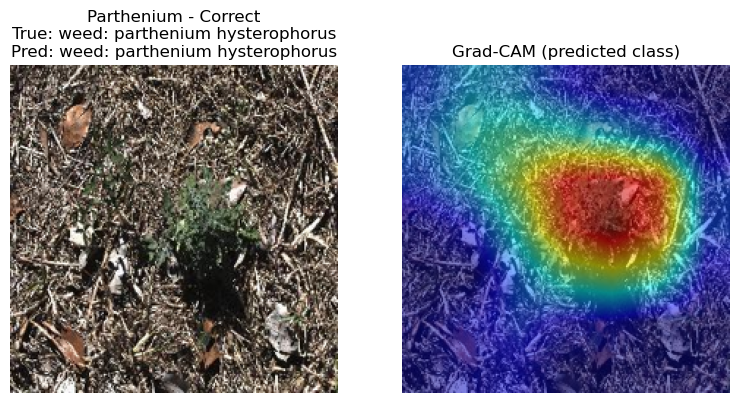

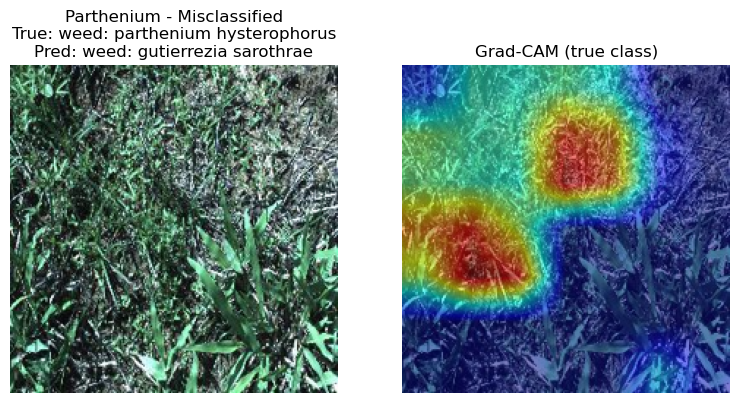

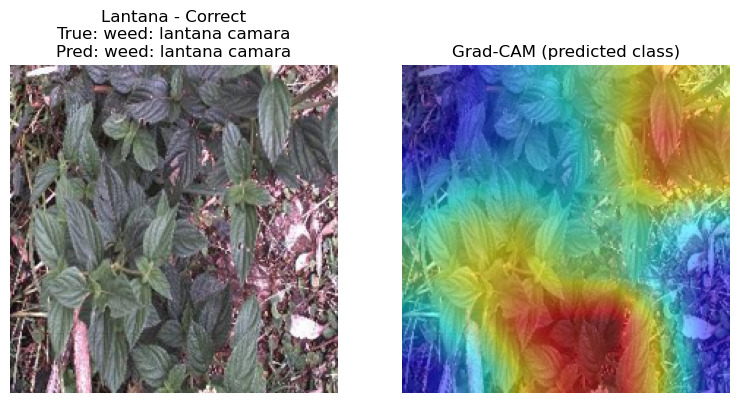

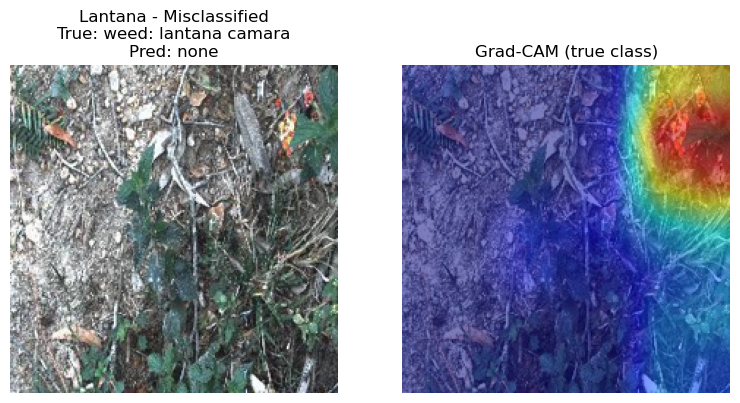

In [60]:
# %%
# 1) Find the numeric IDs for parthenium and lantana from id_to_name
parth_id = None
lantana_id = None

for cid, cname in id_to_name.items():
    if "parthenium" in cname:
        parth_id = cid
    if "lantana camara" in cname:
        lantana_id = cid

print("Parthenium id:", parth_id, "->", id_to_name[parth_id])
print("Lantana id:", lantana_id, "->", id_to_name[lantana_id])

# 2) We assume df_test already has columns:
#    - 'file_name'
#    - 'category_id'
#    - 'y_true'
#    - 'y_pred'
#    If your column names differ, adjust below.

# Parthenium examples
parth_correct = df_test[
    (df_test["category_id"] == parth_id) &
    (df_test["y_true"] == df_test["y_pred"])
].head(1)

parth_mis = df_test[
    (df_test["category_id"] == parth_id) &
    (df_test["y_true"] != df_test["y_pred"])
].head(1)

parth_correct = parth_correct.iloc[0] if len(parth_correct) > 0 else None
parth_mis = parth_mis.iloc[0] if len(parth_mis) > 0 else None

# Lantana examples
lantana_correct = df_test[
    (df_test["category_id"] == lantana_id) &
    (df_test["y_true"] == df_test["y_pred"])
].head(1)

lantana_mis = df_test[
    (df_test["category_id"] == lantana_id) &
    (df_test["y_true"] != df_test["y_pred"])
].head(1)

lantana_correct = lantana_correct.iloc[0] if len(lantana_correct) > 0 else None
lantana_mis = lantana_mis.iloc[0] if len(lantana_mis) > 0 else None

print("Found parthenium correct:", parth_correct is not None)
print("Found parthenium misclassified:", parth_mis is not None)
print("Found lantana correct:", lantana_correct is not None)
print("Found lantana misclassified:", lantana_mis is not None)

# 3) Actually plot Grad-CAMs

# Parthenium - correct, explain predicted class
if parth_correct is not None:
    show_gradcam_for_row(
        row=parth_correct,
        model_cpu=resnet50_cpu,
        target_layers=target_layers,
        root_dir=IMAGES_ROOT,
        eval_transform=eval_transform,
        use_true_class=False,   # explain predicted class
        title_prefix="Parthenium - Correct"
    )

# Parthenium - misclassified, explain TRUE class
if parth_mis is not None:
    show_gradcam_for_row(
        row=parth_mis,
        model_cpu=resnet50_cpu,
        target_layers=target_layers,
        root_dir=IMAGES_ROOT,
        eval_transform=eval_transform,
        use_true_class=True,    # explain true class
        title_prefix="Parthenium - Misclassified"
    )

# Lantana - correct, explain predicted class
if lantana_correct is not None:
    show_gradcam_for_row(
        row=lantana_correct,
        model_cpu=resnet50_cpu,
        target_layers=target_layers,
        root_dir=IMAGES_ROOT,
        eval_transform=eval_transform,
        use_true_class=False,
        title_prefix="Lantana - Correct"
    )

# Lantana - misclassified, explain TRUE class
if lantana_mis is not None:
    show_gradcam_for_row(
        row=lantana_mis,
        model_cpu=resnet50_cpu,
        target_layers=target_layers,
        root_dir=IMAGES_ROOT,
        eval_transform=eval_transform,
        use_true_class=True,
        title_prefix="Lantana - Misclassified"
    )


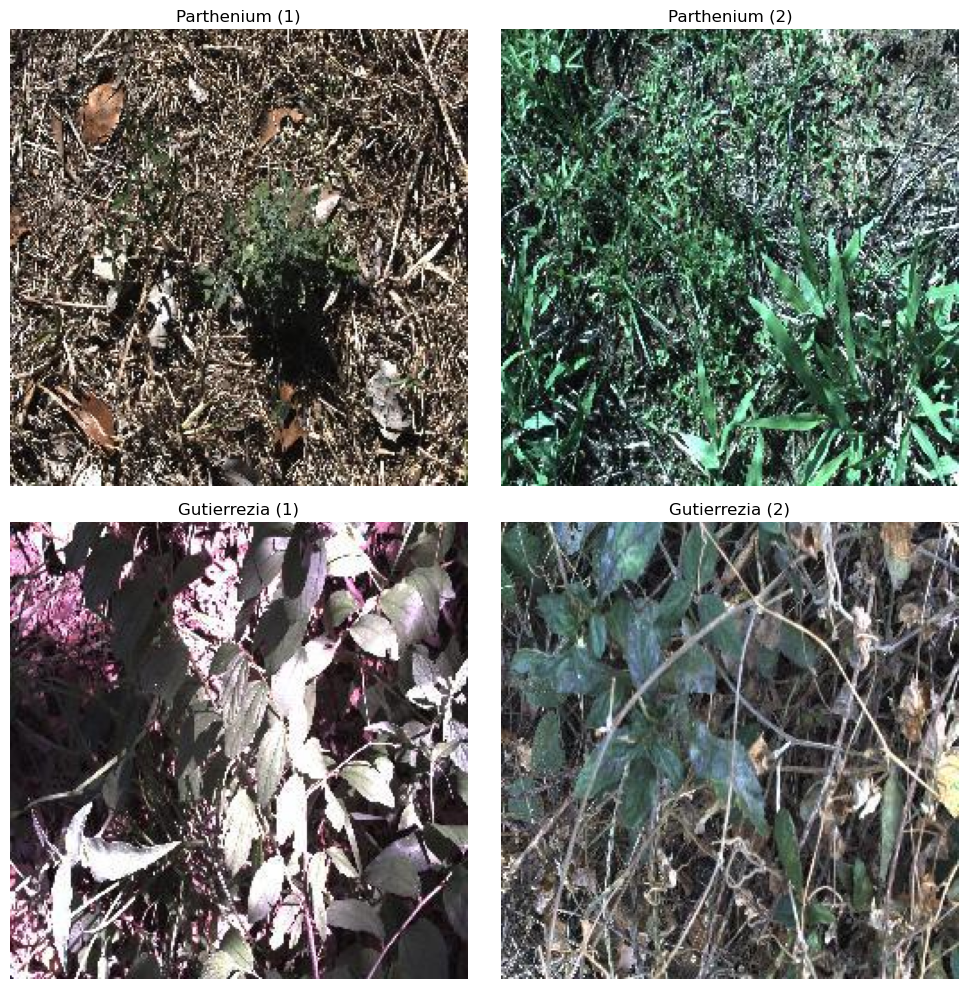

In [75]:
import matplotlib.pyplot as plt
from PIL import Image
from pathlib import Path

# Make sure IMAGES_ROOT is a Path to your images folder
# IMAGES_ROOT = Path("/path/to/images")  # if not already defined

# Numeric IDs
parth_id = 3   # weed: parthenium hysterophorus
guti_id  = 7   # weed: gutierrezia sarothrae

# Select two images from each class
parth_rows = df_test[df_test["category_id"] == parth_id].head(2)
guti_rows  = df_test[df_test["category_id"] == guti_id].head(2)

# Build full paths
image_paths = [
    IMAGES_ROOT / parth_rows.iloc[0]["file_name"],
    IMAGES_ROOT / parth_rows.iloc[1]["file_name"],
    IMAGES_ROOT / guti_rows.iloc[0]["file_name"],
    IMAGES_ROOT / guti_rows.iloc[1]["file_name"],
]

titles = [
    "Parthenium (1)",
    "Parthenium (2)",
    "Gutierrezia (1)",
    "Gutierrezia (2)",
]

# Plot 2x2 grid
plt.figure(figsize=(10, 10))
for i, (path, title) in enumerate(zip(image_paths, titles)):
    img = Image.open(path).convert("RGB")
    plt.subplot(2, 2, i + 1)
    plt.imshow(img)
    plt.title(title)
    plt.axis("off")

plt.tight_layout()
plt.show()

